<a href="https://colab.research.google.com/github/man1sh1409/fakeNewsSocialMediaProspective/blob/main/fake_news_detection1_22.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### run below cell to mount your drive


In [37]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


#Feature Extraction code

## install these module

In [38]:
pip install -q transformers

In [39]:
pip install nltk

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [40]:
pip install textstat

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


## just import 

In [41]:
import pandas as pd

In [42]:
import textstat
import re
import csv
import urllib.parse
import torch
# from transformers import AutoModelForSequenceClassification, AutoTokenizer
import requests
import time
import json
import sys
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize, sent_tokenize
import nltk
from nltk.tag import pos_tag
from nltk.corpus import stopwords
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.feature_extraction.text import CountVectorizer
from nltk.sentiment import SentimentIntensityAnalyzer

nltk.download('vader_lexicon')
nltk.download('wordnet')
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
nltk.download('stopwords')
stop_words = set(stopwords.words('english'))
csv.field_size_limit(sys.maxsize)

[nltk_data] Downloading package vader_lexicon to /root/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /root/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


9223372036854775807

## helper function

In [43]:
phising_url_mpp = dict()

In [44]:
# with open('/content/drive/MyDrive/dataset/phishing-url/phishing-url.csv', newline='') as csvfile:
#   reader = csv.DictReader(csvfile)
#   for i in reader:
#     phising_url_mpp[i['url']]=int(i['score'])

In [45]:
def preprocess_text(text):
  # Tokenize text
  tokens = word_tokenize(text)

  # Remove stopwords
  stop_words = set(stopwords.words('english'))
  filtered_tokens = [word for word in tokens if word.lower() not in stop_words]

  # Lemmatize words
  lemmatizer = WordNetLemmatizer()
  lemmatized_tokens = [lemmatizer.lemmatize(word.lower()) for word in filtered_tokens]

  # Return preprocessed text
  return ' '.join(lemmatized_tokens)

In [46]:
alphabets= "([A-Za-z])"
prefixes = "(Mr|St|Mrs|Ms|Dr)[.]"
suffixes = "(Inc|Ltd|Jr|Sr|Co)"
starters = "(Mr|Mrs|Ms|Dr|Prof|Capt|Cpt|Lt|He\s|She\s|It\s|They\s|Their\s|Our\s|We\s|But\s|However\s|That\s|This\s|Wherever)"
acronyms = "([A-Z][.][A-Z][.](?:[A-Z][.])?)"
websites = "[.](com|net|org|io|gov|edu|me)"
digits = "([0-9])"
multiple_dots = r'\.{2,}'

def split_into_sentences(text: str) -> list[str]:
    """
    Split the text into sentences.

    If the text contains substrings "<prd>" or "<stop>", they would lead 
    to incorrect splitting because they are used as markers for splitting.

    :param text: text to be split into sentences
    :type text: str

    :return: list of sentences
    :rtype: list[str]
    """
    text = " " + text + "  "
    text = text.replace("\n"," ")
    text = re.sub(prefixes,"\\1<prd>",text)
    text = re.sub(websites,"<prd>\\1",text)
    text = re.sub(digits + "[.]" + digits,"\\1<prd>\\2",text)
    text = re.sub(multiple_dots, lambda match: "<prd>" * len(match.group(0)) + "<stop>", text)
    if "Ph.D" in text: text = text.replace("Ph.D.","Ph<prd>D<prd>")
    text = re.sub("\s" + alphabets + "[.] "," \\1<prd> ",text)
    text = re.sub(acronyms+" "+starters,"\\1<stop> \\2",text)
    text = re.sub(alphabets + "[.]" + alphabets + "[.]" + alphabets + "[.]","\\1<prd>\\2<prd>\\3<prd>",text)
    text = re.sub(alphabets + "[.]" + alphabets + "[.]","\\1<prd>\\2<prd>",text)
    text = re.sub(" "+suffixes+"[.] "+starters," \\1<stop> \\2",text)
    text = re.sub(" "+suffixes+"[.]"," \\1<prd>",text)
    text = re.sub(" " + alphabets + "[.]"," \\1<prd>",text)
    if "”" in text: text = text.replace(".”","”.")
    if "\"" in text: text = text.replace(".\"","\".")
    if "!" in text: text = text.replace("!\"","\"!")
    if "?" in text: text = text.replace("?\"","\"?")
    text = text.replace(".",".<stop>")
    text = text.replace("?","?<stop>")
    text = text.replace("!","!<stop>")
    text = text.replace("<prd>",".")
    sentences = text.split("<stop>")
    sentences = [s.strip() for s in sentences]
    if sentences and not sentences[-1]: sentences = sentences[:-1]
    return sentences


In [47]:
def phishing_url_score_fe(phising_url):
  API_key ='6874343ff58ee2ea10dae6ec40978e9647b03a1dbb72870295bcb540fd41738f'
  url = 'https://www.virustotal.com/vtapi/v2/url/report'
  res = []
  if phising_url in phising_url_mpp.keys():
    if phising_url_mpp[phising_url]!=900:
      return phising_url_mpp[phising_url]
  parameters = {'apikey': API_key, 'resource': url}
  try:
    time.sleep(16)
    response= requests.get(url=url, params=parameters,timeout=5)
    if response.status_code==200:
      json_response= json.loads(response.text)
      if json_response['response_code']==1:
        phising_url_mpp[phising_url]=json_response['positives']
      else:
        phising_url_mpp[phising_url]=90
    else:
      phising_url_mpp[phising_url]=90
  except:
    phising_url_mpp[phising_url]=900
  with open('/content/drive/MyDrive/dataset/phishing-url/phishing-url.csv', mode='a', newline='') as file:
    writer = csv.writer(file)
    writer.writerow([phising_url, phising_url_mpp[phising_url]])
  return phising_url_mpp[phising_url]

In [48]:
phis_df=pd.read_csv('/content/drive/MyDrive/dataset/phishing-url/phishing-url.csv')

In [49]:
phis_df.sample(200)

,url,score
9,usuncut.com,0
175,www.flowersforsenate.org,0
297,www.thevenusproject.com,0
16,www.nytimes.com,0
276,shop.wikileaks.org,0
...,...,...
420,richardturcotte.com,0
156,www.dolorescannon.com,0
210,doctor.ndtv.com,0
51,senaldealerta.pe,0


## list of functions

In [50]:
### Feature Extraction
    ## Complexity Features
        # 01. total_word_cnt <-
        # 02. total_char_cnt <-
        # 03. special_character <-
        # 04. upper_case <-
        # 05. lower_case <-
        # 06. short_sentences <-
        # 07. long_sentences <-
        # 08. question_marks <-
        # 09. exclamation_marks <-
    ## Stylometric Features
        # 10. adjective_count <-
        # 11. adverb_count <-
        # 12. present_tense_cnt <-
        # 13. past_tense_cnt <-
        # 14. future_tense_cnt <-
    ## 
        # 15. hyperlinks <-
        # 16. hyperlinks_diversity <-
        # 17. phising_score <-
        # 18. sensational_score <-
        # 19. sponsorship_score <-
        # 20. headline_content_symmetry_score <-
        # 21. gfi_readability_score <-
        # 22. smog_readability_score <-
        # 23. fkg_readability_score <-


#### total_word_cnt_fe

In [51]:
def total_word_cnt_fe(content,headline=""):
  return len(content.split())+len(headline.split())

In [52]:
def total_char_cnt_fe(content,headline=""):
  return len(content)+len(headline)

#### special_character_fe

In [53]:
# 01. special_character

specialCharecters = "`~@#$%^&*()_-+={}[]:;'<>,./\\|\""

def special_character_fe(content, headline=""):
  ans = 0
  for i in headline:
    if i in specialCharecters:
      ans += 1
  for i in content:
    if i in specialCharecters:
      ans += 1
  return ans

#### upper_case_fe

In [54]:
# 02. upper_case
def upper_case_fe(content, headline=""):
  ans = 0
  # length=len(content)
  for i in headline:
    if i<='Z' and i>='A':
      ans += 1
  for i in content:
    if i<='Z' and i>='A':
      ans += 1
  return ans

#### lower_case_fe

In [55]:
# 03. lower_case
def lower_case_fe(content, headline=""):
  ans = 0
  for i in headline:
    if i<='z' and i>='a':
      ans += 1
  for i in content:
    if i<='z' and i>='a':
      ans += 1
  return ans

#### length_sentences_fe
short long sentence

In [56]:
# 04. short_sentences
# 05. long_sentences
def length_sentences_fe(content, headline=""):

  headline_sentences = split_into_sentences(headline)
  content_sentences = split_into_sentences(content)

  short_sentence_cnt = 0
  long_sentence_cnt = 0

  for i in headline_sentences:
    if len(i.split(' '))<=12:
      short_sentence_cnt += 1
    else:
      long_sentence_cnt += 1
  
  for i in content_sentences:
    if len(i.split(' '))<=12:
      short_sentence_cnt += 1
    else:
      long_sentence_cnt += 1
  
  ttl = short_sentence_cnt+long_sentence_cnt
  if ttl==0:
    return pd.Series([0, 0])
  
  return pd.Series([short_sentence_cnt/ttl, long_sentence_cnt/ttl])
  # return [short_sentence_cnt/ttl, long_sentence_cnt/ttl]

#### question_marks_fe

In [57]:
# 06. Question Marks

def question_marks_fe(content, headline=""):
  ans = 0
  for i in headline:
    if i=='?':
      ans += 1
  for i in content:
    if i=='?':
      ans += 1
  return ans

#### exclamation_marks_fe

In [58]:
# 07. Exclamation Marks

def exclamation_marks_fe(content, headline=""):
  ans = 0
  for i in headline:
    if i=='!':
      ans += 1
  for i in content:
    if i=='!':
      ans += 1
  return ans

#### adj_and_adv_count_fe

In [59]:
# 08. adjective_count

def adj_and_adv_count_fe(content, headline=""):
  adjective_cnt= 0
  adverb_cnt=0

  content_tokenized = sent_tokenize(content)
  for i in content_tokenized:
    content_token = word_tokenize(i)
    content_token = [w for w in content_token if not w in stop_words]
    content_tagged = pos_tag(content_token)
    for j in content_tagged:
      if j[1]=='JJ' or j[1]=='JJR' or j[1]=='JJS':
        adjective_cnt += 1
      if j[1]=='RB' or j[1]=='RBR' or j[1]=='RBS' or j[1]=='WRB':
        adverb_cnt+=1

  headline_tokenized = sent_tokenize(headline)
  for i in headline_tokenized:
    headline_token = word_tokenize(i)
    headline_token = [w for w in headline_token if not w in stop_words]
    headline_tagged = pos_tag(headline_token)
    for j in headline_tagged:
      if j[1]=='JJ' or j[1]=='JJR' or j[1]=='JJS':
        adjective_cnt += 1
      if j[1]=='RB' or j[1]=='RBR' or j[1]=='RBS' or j[1]=='WRB':
        adverb_cnt+=1

  return pd.Series([adjective_cnt, adverb_cnt])
  # return [adjective_cnt, adverb_cnt]

#### Tense Score FE

In [60]:
def tense_score_fe(content, headline=""):
  # Sample document
  document = headline + ". "+ content

  # Tokenize the document
  tokens = word_tokenize(document)

  # Perform POS tagging
  tagged_tokens = nltk.pos_tag(tokens)

  # Initialize counters for past, present, and future tense verbs
  past_tense_count = 0
  present_tense_count = 0
  future_tense_count = 0

  # Loop through the tagged tokens and count the frequency of past, present, and future tense verbs
  for word, tag in tagged_tokens:
      if tag == 'VBD':  # past tense verb
          past_tense_count += 1
      elif tag == 'VBZ' or tag == 'VBP':  # present tense verb
          present_tense_count += 1
      elif tag == 'MD':  # modal verb indicating future tense
          future_tense_count += 1

  return pd.Series([present_tense_count, past_tense_count, future_tense_count])

#### hyperlinks_fe

In [61]:
def hyperlinks_fe(content, headline=""):
  headline_urls = re.findall('https?://(?:[-\w.]|(?:%[\da-fA-F]{2}))+', headline)
  content_urls = re.findall('https?://(?:[-\w.]|(?:%[\da-fA-F]{2}))+', content)
  
  mpp = dict()

  for i in headline_urls:
    domain = urllib.parse.urlparse(i).netloc
    if domain in mpp.keys():
      mpp[domain] += 1
    else:
      mpp[domain] = 1
  
  for i in content_urls:
    domain = urllib.parse.urlparse(i).netloc
    if domain in mpp.keys():
      mpp[domain] += 1
    else:
      mpp[domain] = 1
  HyperLink_Count = 0
  HyperLink_Diversity = 0
  Phising_Score= 0
  for i in mpp:
    HyperLink_Count += mpp[i]
    HyperLink_Diversity += (mpp[i] * mpp[i])
    Phising_Score += phishing_url_score_fe(i)*mpp[i]
  return pd.Series([HyperLink_Count, HyperLink_Diversity, Phising_Score])
  # return [HyperLink_Count, HyperLink_Diversity, Phising_Score]

#### sentimental_score_fe

In [62]:
# 13. Sensational Score

def sentimental_score_fe(content, headline=""):
  text = headline + ". " + content
  sia = SentimentIntensityAnalyzer()

  # Get the sentiment polarity (range from -1 to 1, where -1 is negative, 0 is neutral, and 1 is positive)
  sentiment_score = sia.polarity_scores(text)['compound']

  return sentiment_score
  # # Load the sentiment analysis model and tokenizer
  # model_name = "nlptown/bert-base-multilingual-uncased-sentiment"
  # model = AutoModelForSequenceClassification.from_pretrained(model_name)
  # tokenizer = AutoTokenizer.from_pretrained(model_name)

  # # Example input
  # input_text = headline + ". " + content 

  # # Tokenize the input
  # encoded_input = tokenizer.encode_plus(
  #     input_text,
  #     max_length=512,
  #     padding="max_length",
  #     truncation=True,
  #     return_tensors="pt",
  # )

  # # Pass the input tensor to the model
  # output = model(encoded_input['input_ids'], attention_mask=encoded_input['attention_mask'])
  # output = output['logits'].detach().numpy()
  # ans = 0
  # for i in output:
  #   for j in i:
  #     ans += j
  # return ans

#### sponsorship_score_fe

In [63]:
# 14. sponsorship_score

sponsorship_words = ['adherent', 'advocacy', 'advocate', 'aegis', 'aid', 'alms', 'angel', 'atonement', 'auspices', 'backer', 'backing', 'bene-faction', 'benefactor', 'beneficence', 'bid', 'charity', 'contribution', 'egis', 'endeavor', 'essay', 'expiation', 'feeler', 'gift', 'godparent', 'grubstaker', 'guarantor', 'guardianship', 'hit', 'mainstay', 'oblation', 'offer', 'offered', 'offering', 'overture', 'pass', 'patron', 'patron', 'patronage', 'pitch', 'present', 'presentation', 'promoter', 'proposition', 'propoundment', 'protectorship', 'rendition', 'sacrifice', 'sponsor', 'submission', 'subscription', 'support', 'supporter', 'surety', 'sustainer', 'tender', 'tutelage', 'underwriter']
def sponsorship_score_fe(content, headline=""):
  headline_token = word_tokenize(headline)
  content_token = word_tokenize(content)
  text_stem = []
  sponsor_Word_cnt = 0
  lemmatizer = WordNetLemmatizer()
  for i in headline_token:
    text_stem.append(lemmatizer.lemmatize(i))
  for i in content_token:
    text_stem.append(lemmatizer.lemmatize(i))
  for i in text_stem:
    if i in sponsorship_words:
      sponsor_Word_cnt += 1
  return sponsor_Word_cnt

#### headline_content_symmetry_score_fe

In [64]:
# 15. headline_content_symmetry_score

def headline_content_symmetry_score_fe(content, headline=""):
  if headline=="":
    return 1.0

  preprocessed_text1 = preprocess_text(content)
  preprocessed_text2 = preprocess_text(headline)

  vectorizer = CountVectorizer().fit_transform([preprocessed_text1, preprocessed_text2])
  similarity = cosine_similarity(vectorizer)[0][1]
  return similarity

#### readability_score_fe

In [65]:
def readability_score_fe(content, headline=""):
  text = headline + ". "+ content

  # Calculate the Gunning Fog Index
  gfi_readability_score = textstat.gunning_fog(text)

  # Calculate the SMOG Grade
  smog_readability_score = textstat.smog_index(text)

  # Calculate the Flesch-Kincaid Grade Level
  fkg_readability_score = textstat.flesch_kincaid_grade(text)

  return pd.Series([gfi_readability_score, smog_readability_score, fkg_readability_score])

#### driver code of all upper function

In [66]:
### Feature Extraction
    ## Complexity Features
        # 00. total_word_cnt <-
        # 01. special_character <-
        # 02. upper_case <-
        # 03. lower_case <-
        # 04. short_sentences <-
        # 05. long_sentences <-
        # 06. question_marks <-
        # 07. exclamation_marks <-
    ## Stylometric Features
        # 08. adjective_count <-
        # 09. adverb_count <-
    ## 
        # 10. hyperlinks <-
        # 11. hyperlinks_diversity <-
        # 12. phising_score <-
        # 13. sensational_score <-
        # 14. sponsorship_score <-
        # 15. headline_content_symmetry_score <-

def add_feature(news):
  news['total_word_cnt'] = total_word_cnt_fe(news['content'], news['headline'])
  news['special_character'] = special_character_fe(news['content'], news['headline'])
  news['upper_case'] = upper_case_fe(news['content'], news['headline'])
  news['lower_case'] = lower_case_fe(news['content'], news['headline'])

  length_sen = length_sentences_fe(news['content'], news['headline'])
  news['short_sentences'] = length_sen[0]
  news['long_sentences'] = length_sen[1]

  news['question_marks'] = question_marks_fe(news['content'], news['headline'])
  news['exclamation_marks'] = exclamation_marks_fe(news['content'], news['headline'])
  
  adj_adv = adj_and_adv_count_fe(news['content'], news['headline'])
  news['adjective_count'] = adj_adv[0]
  news['adverb_count'] = adj_adv[1]

  hyperLinks = hyperlinks_fe(news['content'], news['headline'])
  news['hyperlinks'] = hyperLinks[0]
  news['hyperlinks_diversity'] = hyperLinks[1]
  news['phising_score'] = hyperLinks[2]

  news['sensational_score'] = sentimental_score_fe(news['content'], news['headline'])
  news['sponsorship_score'] = sponsorship_score_fe(news['content'], news['headline'])
  news['headline_content_symmetry_score'] = headline_content_symmetry_score_fe(news['content'], news['headline'])
  
  return news

#### -------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------




# Model Train





### imports for model training

In [67]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC
from sklearn.metrics import accuracy_score
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split
import seaborn as sns
from bs4 import BeautifulSoup
from sklearn import preprocessing
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import confusion_matrix,precision_score,recall_score,f1_score,ConfusionMatrixDisplay

### model object instation

In [68]:
lr=LogisticRegression(max_iter=3000)
svc_clf=SVC()
rand_forest= RandomForestClassifier()
knn = KNeighborsClassifier(n_neighbors=20)

### model_train function

In [69]:
def model_train(model_obj,x_train,y_train,x_test,y_test):

  model_obj.fit(x_train,y_train)
  # prediction_on train data
  y_pred_t=model_obj.predict(x_train)
  #prediction_on test data
  y_pred=model_obj.predict(x_test)
  # accuracy score on train data 
  ac_t=accuracy_score(y_train,y_pred_t)
  ac=accuracy_score(y_test,y_pred)
  
  return (y_pred,ac_t,ac)

### model_trainer helper function

In [70]:
def model_helper(x_train,y_train,x_test,y_test):
  acc_score_t=[]
  acc_score=[]
  # logistic Regresion
  y_pred,ac_t,ac=model_train(lr,x_train,y_train,x_test,y_test)
  acc_score_t.append(ac_t)
  acc_score.append(ac)

  # SVC
  y_pred_svc,ac_t,ac=model_train(svc_clf,x_train,y_train,x_test,y_test)
  acc_score_t.append(ac_t)
  acc_score.append(ac)

  # Random Forest
  y_pred_rand,ac_t,ac=model_train(rand_forest,x_train,y_train,x_test,y_test)
  acc_score_t.append(ac_t)
  acc_score.append(ac)

  # KNN
  y_pred_knn,ac_t,ac=model_train(knn,x_train,y_train,x_test,y_test)
  acc_score_t.append(ac_t)
  acc_score.append(ac)

  return acc_score_t,acc_score

### confusion matrix function

In [71]:
def SaveConfusionMatrix(model:str,y_actual,y_predicted,path):
  # i is indexOfSubplot
  conf_mat=confusion_matrix(y_actual,y_predicted)
  varname='confusion_'+ model
  con_dis=ConfusionMatrixDisplay(confusion_matrix = conf_mat, display_labels = ['Fake', 'Real'])
  #plt.subplot(20,20,1+i)
  con_dis.plot()
  plt.savefig(f'/content/drive/MyDrive/dataset/{path}/{varname}.png')

### precision Recall f1 score function

In [72]:
def precision_recall_f1_score(model,y_actual,y_predicted):
  prec_score=precision_score(y_actual,y_predicted)
  rec_score=recall_score(y_actual,y_predicted)
  f1Score=f1_score(y_actual,y_predicted)
  # print(f'{model} P,R,F1 score are: {prec_score},{rec_score},{f1Score}')
  return [prec_score,rec_score,f1Score]

## Data-set-1

### news dataset import

In [ ]:
news_data=pd.read_csv('/content/drive/MyDrive/dataset/data-set-1/news.csv')
news_data.head()

,Unnamed: 0,title,text,label
0,8476,You Can Smell Hillary’s Fear,"Daniel Greenfield, a Shillman Journalism Fello...",FAKE
1,10294,Watch The Exact Moment Paul Ryan Committed Pol...,Google Pinterest Digg Linkedin Reddit Stumbleu...,FAKE
2,3608,Kerry to go to Paris in gesture of sympathy,U.S. Secretary of State John F. Kerry said Mon...,REAL
3,10142,Bernie supporters on Twitter erupt in anger ag...,"— Kaydee King (@KaydeeKing) November 9, 2016 T...",FAKE
4,875,The Battle of New York: Why This Primary Matters,It's primary day in New York and front-runners...,REAL


In [ ]:
news_data.drop(columns=['Unnamed: 0'],inplace=True,axis=1)
news_data.head()

,title,text,label
0,You Can Smell Hillary’s Fear,"Daniel Greenfield, a Shillman Journalism Fello...",FAKE
1,Watch The Exact Moment Paul Ryan Committed Pol...,Google Pinterest Digg Linkedin Reddit Stumbleu...,FAKE
2,Kerry to go to Paris in gesture of sympathy,U.S. Secretary of State John F. Kerry said Mon...,REAL
3,Bernie supporters on Twitter erupt in anger ag...,"— Kaydee King (@KaydeeKing) November 9, 2016 T...",FAKE
4,The Battle of New York: Why This Primary Matters,It's primary day in New York and front-runners...,REAL


In [ ]:
news_data=news_data.replace({'label':{"FAKE":0,"REAL":1}})
news_data.head()

,title,text,label
0,You Can Smell Hillary’s Fear,"Daniel Greenfield, a Shillman Journalism Fello...",0
1,Watch The Exact Moment Paul Ryan Committed Pol...,Google Pinterest Digg Linkedin Reddit Stumbleu...,0
2,Kerry to go to Paris in gesture of sympathy,U.S. Secretary of State John F. Kerry said Mon...,1
3,Bernie supporters on Twitter erupt in anger ag...,"— Kaydee King (@KaydeeKing) November 9, 2016 T...",0
4,The Battle of New York: Why This Primary Matters,It's primary day in New York and front-runners...,1


In [ ]:
news_data.shape

(6335, 3)

In [ ]:
news_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6335 entries, 0 to 6334
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   title   6335 non-null   object
 1   text    6335 non-null   object
 2   label   6335 non-null   int64 
dtypes: int64(1), object(2)
memory usage: 148.6+ KB


### train dataset import

In [ ]:
train_data=pd.read_csv('/content/drive/MyDrive/dataset/data-set-1/train.csv')
train_data.head()

,id,title,author,text,label
0,0,House Dem Aide: We Didn’t Even See Comey’s Let...,Darrell Lucus,House Dem Aide: We Didn’t Even See Comey’s Let...,1
1,1,"FLYNN: Hillary Clinton, Big Woman on Campus - ...",Daniel J. Flynn,Ever get the feeling your life circles the rou...,0
2,2,Why the Truth Might Get You Fired,Consortiumnews.com,"Why the Truth Might Get You Fired October 29, ...",1
3,3,15 Civilians Killed In Single US Airstrike Hav...,Jessica Purkiss,Videos 15 Civilians Killed In Single US Airstr...,1
4,4,Iranian woman jailed for fictional unpublished...,Howard Portnoy,Print \r\nAn Iranian woman has been sentenced ...,1


In [ ]:
train_data.drop(columns=['id', 'author'],inplace=True,axis=1)
train_data.head()

,title,text,label
0,House Dem Aide: We Didn’t Even See Comey’s Let...,House Dem Aide: We Didn’t Even See Comey’s Let...,1
1,"FLYNN: Hillary Clinton, Big Woman on Campus - ...",Ever get the feeling your life circles the rou...,0
2,Why the Truth Might Get You Fired,"Why the Truth Might Get You Fired October 29, ...",1
3,15 Civilians Killed In Single US Airstrike Hav...,Videos 15 Civilians Killed In Single US Airstr...,1
4,Iranian woman jailed for fictional unpublished...,Print \r\nAn Iranian woman has been sentenced ...,1


In [ ]:
train_data=train_data.replace({'label':{1:0,0:1}})
train_data.head()

,title,text,label
0,House Dem Aide: We Didn’t Even See Comey’s Let...,House Dem Aide: We Didn’t Even See Comey’s Let...,0
1,"FLYNN: Hillary Clinton, Big Woman on Campus - ...",Ever get the feeling your life circles the rou...,1
2,Why the Truth Might Get You Fired,"Why the Truth Might Get You Fired October 29, ...",0
3,15 Civilians Killed In Single US Airstrike Hav...,Videos 15 Civilians Killed In Single US Airstr...,0
4,Iranian woman jailed for fictional unpublished...,Print \r\nAn Iranian woman has been sentenced ...,0


In [ ]:
train_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20800 entries, 0 to 20799
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   title   20242 non-null  object
 1   text    20761 non-null  object
 2   label   20800 non-null  int64 
dtypes: int64(1), object(2)
memory usage: 487.6+ KB


In [ ]:
train_data.isnull().sum()

title    558
text      39
label      0
dtype: int64

In [ ]:
train_data.sample(5)

,title,text,label
3464,Минобороны: огонь боевиков помешал вывести 40 ...,"27 октября 2016, 05:59 Огонь снайперов помешал...",0
12524,Stockholm Attacker Was ’Rejected Asylum Seeker...,Swedish police revealed Sunday the Uzbekistan ...,1
2675,NaN,"Of course, how much of this Trump could get aw...",0
19204,Italians Rejoice as Soros Ally Mayor Awarded U...,Italians this week cheered the electoral defea...,1
122,“Chapo Trap House”: New Left-Wing Podcast is a...,“Chapo Trap House”: New Left-Wing Podcast is a...,0


In [ ]:
train_data.shape

(20800, 3)

In [ ]:
train_data=train_data.dropna()

In [ ]:
train_data.isnull().sum()

title    0
text     0
label    0
dtype: int64

In [ ]:
train_data.head()

,title,text,label
0,House Dem Aide: We Didn’t Even See Comey’s Let...,House Dem Aide: We Didn’t Even See Comey’s Let...,0
1,"FLYNN: Hillary Clinton, Big Woman on Campus - ...",Ever get the feeling your life circles the rou...,1
2,Why the Truth Might Get You Fired,"Why the Truth Might Get You Fired October 29, ...",0
3,15 Civilians Killed In Single US Airstrike Hav...,Videos 15 Civilians Killed In Single US Airstr...,0
4,Iranian woman jailed for fictional unpublished...,Print \r\nAn Iranian woman has been sentenced ...,0


### concat dataset

In [ ]:
df_temp=[train_data, news_data]

In [ ]:
df_org=pd.concat(df_temp,ignore_index=True)

In [ ]:
df_org.head()

,title,text,label
0,House Dem Aide: We Didn’t Even See Comey’s Let...,House Dem Aide: We Didn’t Even See Comey’s Let...,0
1,"FLYNN: Hillary Clinton, Big Woman on Campus - ...",Ever get the feeling your life circles the rou...,1
2,Why the Truth Might Get You Fired,"Why the Truth Might Get You Fired October 29, ...",0
3,15 Civilians Killed In Single US Airstrike Hav...,Videos 15 Civilians Killed In Single US Airstr...,0
4,Iranian woman jailed for fictional unpublished...,Print \r\nAn Iranian woman has been sentenced ...,0


In [ ]:
df_features=df_org.drop(columns=['label'])

In [ ]:
df_features.head()

,title,text
0,House Dem Aide: We Didn’t Even See Comey’s Let...,House Dem Aide: We Didn’t Even See Comey’s Let...
1,"FLYNN: Hillary Clinton, Big Woman on Campus - ...",Ever get the feeling your life circles the rou...
2,Why the Truth Might Get You Fired,"Why the Truth Might Get You Fired October 29, ..."
3,15 Civilians Killed In Single US Airstrike Hav...,Videos 15 Civilians Killed In Single US Airstr...
4,Iranian woman jailed for fictional unpublished...,Print \r\nAn Iranian woman has been sentenced ...


###  adding features

In [ ]:
### Feature Extraction
    ## Complexity Features
        # 01. total_word_cnt <-
        # 02. total_char_cnt <-
        # 03. special_character <-
        # 04. upper_case <-
        # 05. lower_case <-
        # 06. short_sentences <-
        # 07. long_sentences <-
        # 08. question_marks <-
        # 09. exclamation_marks <-
    ## Stylometric Features
        # 10. adjective_count <-
        # 11. adverb_count <-
        # 12. present_tense_cnt <-
        # 13. past_tense_cnt <-
        # 14. future_tense_cnt <-
    ## 
        # 15. hyperlinks <-
        # 16. hyperlinks_diversity <-
        # 17. phising_score <-
        # 18. sensational_score <-
        # 19. sponsorship_score <-
        # 20. headline_content_symmetry_score <-
        # 21. gfi_readability_score <-
        # 22. smog_readability_score <-
        # 23. fkg_readability_score <-

#### Number of words

In [ ]:
df_features["Number of Words"] = df_features.apply(lambda x: total_word_cnt_fe(x['text'],x['title']),axis=1)
df_features["Number of character"] = df_features.apply(lambda x: total_char_cnt_fe(x['text'],x['title']),axis=1)

#### Number of Specical-Symbol

In [ ]:
df_features['Number of Specical-Symbol'] = df_features.apply(lambda x:special_character_fe(x['text'],x['title']),axis=1)
df_features['Relative Specical-Symbol Count'] = df_features['Number of Specical-Symbol']/df_features["Number of character"]

#### Number of UpperCase

In [ ]:
df_features['Number of UpperCase'] = df_features.apply(lambda x:upper_case_fe(x['text'],x['title']),axis=1)
df_features['Relative UpperCase Count'] = df_features['Number of UpperCase']/df_features["Number of character"]

#### Number of LowerCase

In [ ]:
df_features['Number of LowerCase'] = df_features.apply(lambda x:lower_case_fe(x['text'],x['title']),axis=1)
df_features['Relative LowerCase Count'] = df_features['Number of LowerCase']/df_features["Number of character"]

#### short_sentence_cnt long_sentence_cnt

In [ ]:
df_features[['short_sentence_cnt', 'long_sentence_cnt']] = df_features.apply(lambda x:length_sentences_fe(content = x['text'], headline = x['title']), axis=1)

#### Number of Question-Mark

In [ ]:
df_features['Number of Question-Mark'] = df_features.apply(lambda x:question_marks_fe(x['text'],x['title']),axis=1)
df_features['Relative Question-Mark Count'] = df_features['Number of Question-Mark']/df_features["Number of character"]

#### Number of Exclamation-Mark

In [ ]:
df_features['Number of Exclamation-Mark'] = df_features.apply(lambda x:exclamation_marks_fe(x['text'],x['title']),axis=1)
df_features['Relative Exclamation-Mark Count'] = df_features['Number of Exclamation-Mark']/df_features["Number of character"]

#### Adjective and Adverb Count

In [ ]:
df_features[['adjective_cnt', 'adverb_cnt']] = df_features.apply(lambda x:adj_and_adv_count_fe(content = x['text'], headline = x['title']), axis=1)

In [ ]:
df_features['Relative adjective Count'] = df_features['adjective_cnt']/df_features["Number of Words"]
df_features['Relative adverb Count'] = df_features['adverb_cnt']/df_features["Number of Words"]

#### Tense

In [ ]:
df_features[['present_tense_count', 'past_tense_count', 'future_tense_count']] = df_features.apply(lambda x:tense_score_fe(content = x['text'], headline = x['title']), axis=1)

In [ ]:
df_features['Relative present_tense_count'] = df_features['present_tense_count']/df_features["Number of Words"]
df_features['Relative past_tense_count'] = df_features['past_tense_count']/df_features["Number of Words"]
df_features['Relative future_tense_count'] = df_features['future_tense_count']/df_features["Number of Words"]

#### Hyperlinks

In [ ]:
df_features[['HyperLink Count', 'HyperLink Diversity', 'Phishing Score']] = df_features.apply(lambda x:hyperlinks_fe(content = x['text'], headline = x['title']), axis=1)

#### Sentimental Score

In [ ]:
df_features['Sentimental Score'] = df_features.apply(lambda x:sentimental_score_fe(x['text'],x['title']),axis=1)

#### Sponsor Word Count

In [ ]:
df_features['Sponsor Word Count'] = df_features.apply(lambda x:sponsorship_score_fe(content = x['text'], headline = x['title']), axis=1)
df_features['Relative Sponsor Word Count'] = df_features['Sponsor Word Count']/df_features["Number of Words"]

#### Symmetric_Score

In [ ]:
df_features['Symmetric_Score'] = df_features.apply(lambda x: headline_content_symmetry_score_fe(content = x['text'], headline = x['title']), axis=1)


#### Readability Score

In [ ]:
df_features[['gfi_readability_score', 'smog_readability_score', 'fkg_readability_score']] = df_features.apply(lambda x:readability_score_fe(content = x['text'], headline = x['title']), axis=1)

#### Save to drive

In [ ]:
df_features.head()

,title,text,Number of Words,Number of character,Number of Specical-Symbol,Relative Specical-Symbol Count,Number of UpperCase,Relative UpperCase Count,Number of LowerCase,Relative LowerCase Count,...,HyperLink Count,HyperLink Diversity,Phishing Score,Sentimental Score,Sponsor Word Count,Relative Sponsor Word Count,Symmetric_Score,gfi_readability_score,smog_readability_score,fkg_readability_score
0,House Dem Aide: We Didn’t Even See Comey’s Let...,House Dem Aide: We Didn’t Even See Comey’s Let...,834,5021,89,0.017726,224,0.044613,3799,0.756622,...,0,0,0,0.1531,1,0.001199,0.498815,11.76,12.2,10.6
1,"FLYNN: Hillary Clinton, Big Woman on Campus - ...",Ever get the feeling your life circles the rou...,719,4215,73,0.017319,116,0.027521,3212,0.762040,...,0,0,0,-0.7112,2,0.002782,0.268717,11.63,11.9,10.3
2,Why the Truth Might Get You Fired,"Why the Truth Might Get You Fired October 29, ...",1273,7747,180,0.023235,232,0.029947,5946,0.767523,...,0,0,0,0.9949,5,0.003928,0.156456,11.39,12.9,10.8
3,15 Civilians Killed In Single US Airstrike Hav...,Videos 15 Civilians Killed In Single US Airstr...,567,3312,51,0.015399,140,0.042271,2486,0.750604,...,0,0,0,-0.9993,3,0.005291,0.420980,11.23,11.7,9.4
4,Iranian woman jailed for fictional unpublished...,Print \r\nAn Iranian woman has been sentenced ...,168,1035,16,0.015459,22,0.021256,807,0.779710,...,0,0,0,-0.9753,0,0.000000,0.458664,14.82,13.6,13.9


In [ ]:
df_features['label']=df_org.iloc[:,-1:]
df_features.head()

,title,text,Number of Words,Number of character,Number of Specical-Symbol,Relative Specical-Symbol Count,Number of UpperCase,Relative UpperCase Count,Number of LowerCase,Relative LowerCase Count,...,HyperLink Diversity,Phishing Score,Sentimental Score,Sponsor Word Count,Relative Sponsor Word Count,Symmetric_Score,gfi_readability_score,smog_readability_score,fkg_readability_score,label
0,House Dem Aide: We Didn’t Even See Comey’s Let...,House Dem Aide: We Didn’t Even See Comey’s Let...,834,5021,89,0.017726,224,0.044613,3799,0.756622,...,0,0,0.1531,1,0.001199,0.498815,11.76,12.2,10.6,0
1,"FLYNN: Hillary Clinton, Big Woman on Campus - ...",Ever get the feeling your life circles the rou...,719,4215,73,0.017319,116,0.027521,3212,0.762040,...,0,0,-0.7112,2,0.002782,0.268717,11.63,11.9,10.3,1
2,Why the Truth Might Get You Fired,"Why the Truth Might Get You Fired October 29, ...",1273,7747,180,0.023235,232,0.029947,5946,0.767523,...,0,0,0.9949,5,0.003928,0.156456,11.39,12.9,10.8,0
3,15 Civilians Killed In Single US Airstrike Hav...,Videos 15 Civilians Killed In Single US Airstr...,567,3312,51,0.015399,140,0.042271,2486,0.750604,...,0,0,-0.9993,3,0.005291,0.420980,11.23,11.7,9.4,0
4,Iranian woman jailed for fictional unpublished...,Print \r\nAn Iranian woman has been sentenced ...,168,1035,16,0.015459,22,0.021256,807,0.779710,...,0,0,-0.9753,0,0.000000,0.458664,14.82,13.6,13.9,0


In [ ]:
df_features.shape

(26538, 37)

In [ ]:
df_features.to_csv('/content/drive/MyDrive/dataset/data-set-1/with-37-features.csv')


### Feature Selection

In [73]:
df=pd.read_csv('/content/drive/MyDrive/dataset/data-set-1/Fake_news_with-37-features.csv')
df = df.drop(columns=['Unnamed: 0'])
df.head()

,title,text,Number of Words,Number of character,Number of Specical-Symbol,Relative Specical-Symbol Count,Number of UpperCase,Relative UpperCase Count,Number of LowerCase,Relative LowerCase Count,...,HyperLink Diversity,Phishing Score,Sentimental Score,Sponsor Word Count,Relative Sponsor Word Count,Symmetric_Score,gfi_readability_score,smog_readability_score,fkg_readability_score,label
0,House Dem Aide: We Didn’t Even See Comey’s Let...,House Dem Aide: We Didn’t Even See Comey’s Let...,834,5021,89,0.017726,224,0.044613,3799,0.756622,...,0,0,0.1531,1,0.001199,0.498815,11.76,12.2,10.6,0
1,"FLYNN: Hillary Clinton, Big Woman on Campus - ...",Ever get the feeling your life circles the rou...,719,4215,73,0.017319,116,0.027521,3212,0.762040,...,0,0,-0.7112,2,0.002782,0.268717,11.63,11.9,10.3,1
2,Why the Truth Might Get You Fired,"Why the Truth Might Get You Fired October 29, ...",1273,7747,180,0.023235,232,0.029947,5946,0.767523,...,0,0,0.9949,5,0.003928,0.156456,11.39,12.9,10.8,0
3,15 Civilians Killed In Single US Airstrike Hav...,Videos 15 Civilians Killed In Single US Airstr...,567,3312,51,0.015399,140,0.042271,2486,0.750604,...,0,0,-0.9993,3,0.005291,0.420980,11.23,11.7,9.4,0
4,Iranian woman jailed for fictional unpublished...,Print \r\nAn Iranian woman has been sentenced ...,168,1035,16,0.015459,22,0.021256,807,0.779710,...,0,0,-0.9753,0,0.000000,0.458664,14.82,13.6,13.9,0


In [ ]:
df.shape

(26538, 37)

In [ ]:
df = df.drop(columns=['Number of Words','Number of character', 'Number of Specical-Symbol', 'Number of UpperCase', 'Number of LowerCase', 'Number of Question-Mark', 'Number of Exclamation-Mark', 'Sponsor Word Count', 'adjective_cnt', 'adverb_cnt', 'present_tense_count', 'past_tense_count', 'future_tense_count'])
df.head()

,title,text,Relative Specical-Symbol Count,Relative UpperCase Count,Relative LowerCase Count,short_sentence_cnt,long_sentence_cnt,Relative Question-Mark Count,Relative Exclamation-Mark Count,Relative adjective Count,...,HyperLink Count,HyperLink Diversity,Phishing Score,Sentimental Score,Relative Sponsor Word Count,Symmetric_Score,gfi_readability_score,smog_readability_score,fkg_readability_score,label
0,House Dem Aide: We Didn’t Even See Comey’s Let...,House Dem Aide: We Didn’t Even See Comey’s Let...,0.017726,0.044613,0.756622,0.205128,0.794872,0.000000,0.0,0.070743,...,0,0,0,0.1531,0.001199,0.498815,11.76,12.2,10.6,0
1,"FLYNN: Hillary Clinton, Big Woman on Campus - ...",Ever get the feeling your life circles the rou...,0.017319,0.027521,0.762040,0.272727,0.727273,0.000949,0.0,0.082058,...,0,0,0,-0.7112,0.002782,0.268717,11.63,11.9,10.3,1
2,Why the Truth Might Get You Fired,"Why the Truth Might Get You Fired October 29, ...",0.023235,0.029947,0.767523,0.259259,0.740741,0.000516,0.0,0.084839,...,0,0,0,0.9949,0.003928,0.156456,11.39,12.9,10.8,0
3,15 Civilians Killed In Single US Airstrike Hav...,Videos 15 Civilians Killed In Single US Airstr...,0.015399,0.042271,0.750604,0.250000,0.750000,0.000000,0.0,0.072310,...,0,0,0,-0.9993,0.005291,0.420980,11.23,11.7,9.4,0
4,Iranian woman jailed for fictional unpublished...,Print \r\nAn Iranian woman has been sentenced ...,0.015459,0.021256,0.779710,0.000000,1.000000,0.000000,0.0,0.083333,...,0,0,0,-0.9753,0.000000,0.458664,14.82,13.6,13.9,0


### Graph and Plot

In [ ]:

df.head()

,title,text,Relative Specical-Symbol Count,Relative UpperCase Count,Relative LowerCase Count,short_sentence_cnt,long_sentence_cnt,Relative Question-Mark Count,Relative Exclamation-Mark Count,Relative adjective Count,...,HyperLink Count,HyperLink Diversity,Phishing Score,Sentimental Score,Relative Sponsor Word Count,Symmetric_Score,gfi_readability_score,smog_readability_score,fkg_readability_score,label
0,House Dem Aide: We Didn’t Even See Comey’s Let...,House Dem Aide: We Didn’t Even See Comey’s Let...,0.017726,0.044613,0.756622,0.205128,0.794872,0.000000,0.0,0.070743,...,0,0,0,0.1531,0.001199,0.498815,11.76,12.2,10.6,0
1,"FLYNN: Hillary Clinton, Big Woman on Campus - ...",Ever get the feeling your life circles the rou...,0.017319,0.027521,0.762040,0.272727,0.727273,0.000949,0.0,0.082058,...,0,0,0,-0.7112,0.002782,0.268717,11.63,11.9,10.3,1
2,Why the Truth Might Get You Fired,"Why the Truth Might Get You Fired October 29, ...",0.023235,0.029947,0.767523,0.259259,0.740741,0.000516,0.0,0.084839,...,0,0,0,0.9949,0.003928,0.156456,11.39,12.9,10.8,0
3,15 Civilians Killed In Single US Airstrike Hav...,Videos 15 Civilians Killed In Single US Airstr...,0.015399,0.042271,0.750604,0.250000,0.750000,0.000000,0.0,0.072310,...,0,0,0,-0.9993,0.005291,0.420980,11.23,11.7,9.4,0
4,Iranian woman jailed for fictional unpublished...,Print \r\nAn Iranian woman has been sentenced ...,0.015459,0.021256,0.779710,0.000000,1.000000,0.000000,0.0,0.083333,...,0,0,0,-0.9753,0.000000,0.458664,14.82,13.6,13.9,0


In [ ]:
df_train = df.iloc[:,2:]
df_train.head()

,Relative Specical-Symbol Count,Relative UpperCase Count,Relative LowerCase Count,short_sentence_cnt,long_sentence_cnt,Relative Question-Mark Count,Relative Exclamation-Mark Count,Relative adjective Count,Relative adverb Count,HyperLink Count,...,Sentimental Score,Relative Sponsor Word Count,Symmetric_Score,gfi_readability_score,smog_readability_score,fkg_readability_score,Relative present_tense_count,Relative past_tense_count,Relative future_tense_count,label
0,0.025619,0.033665,0.765403,0.264706,0.735294,0.00000,0.00000,0.077734,0.028986,0,...,0.9843,0.005270,0.252640,10.99,12.5,10.9,0.040843,0.036891,0.014493,1
1,0.019319,0.029703,0.788698,0.375000,0.625000,0.00000,0.00000,0.091627,0.012638,0,...,0.1501,0.003160,0.355829,12.45,15.0,12.2,0.030016,0.047393,0.022117,1
2,0.018603,0.043524,0.762373,0.250000,0.750000,0.00000,0.00000,0.059957,0.014989,0,...,-0.6808,0.002141,0.184787,11.64,12.6,10.0,0.038544,0.064240,0.014989,1
3,0.021032,0.046825,0.771032,0.222222,0.777778,0.00000,0.00000,0.080519,0.025974,0,...,-0.2201,0.000000,0.172774,11.43,13.0,10.8,0.031169,0.083117,0.002597,1
4,0.025792,0.038688,0.754409,0.295455,0.704545,0.00019,0.00019,0.076477,0.022016,0,...,0.8055,0.000000,0.476795,9.52,11.2,8.6,0.056779,0.031286,0.003476,1


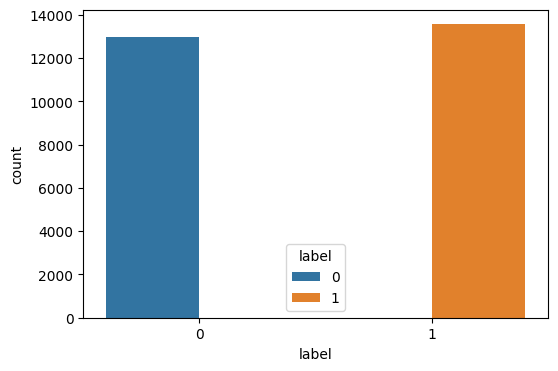

In [ ]:
f = plt.figure()
f.set_figwidth(6)
f.set_figheight(4)
data_dist_1 = sns.countplot(df, x='label', hue='label')
plt.savefig('/content/drive/MyDrive/dataset/data-set-1/data_dist_1.png')

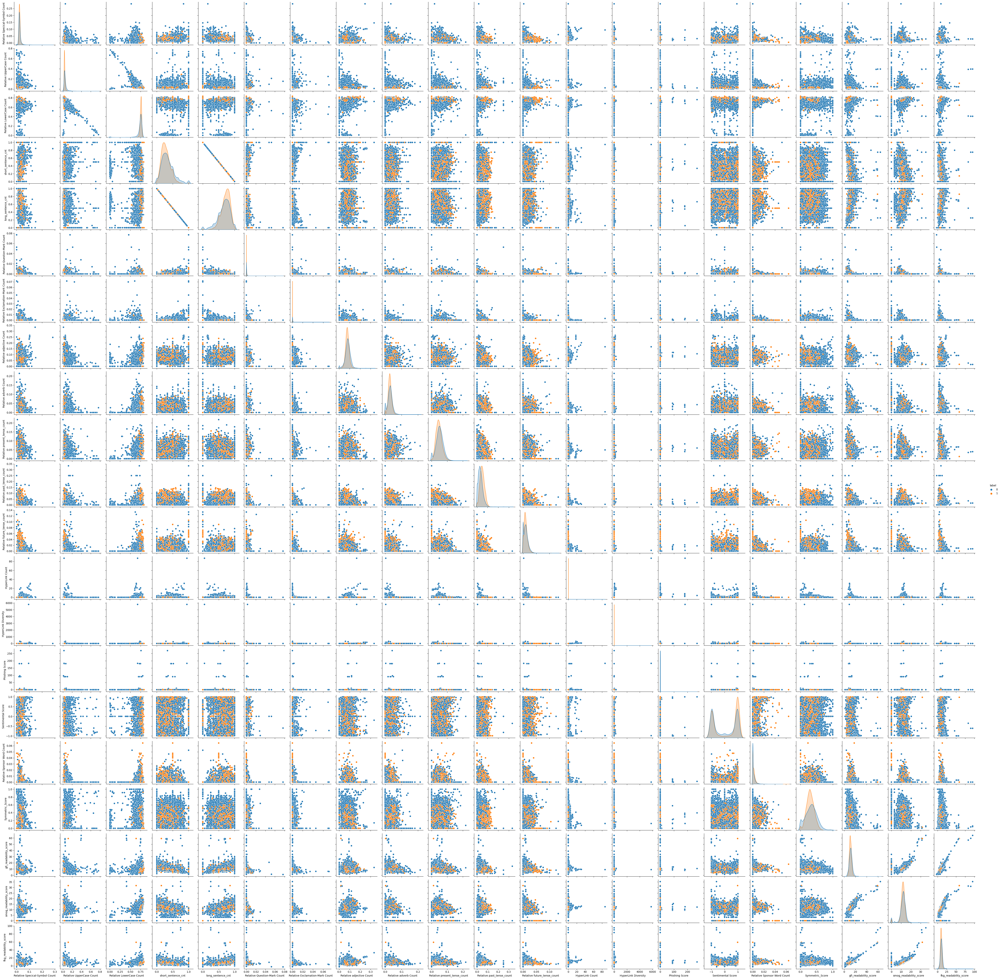

In [ ]:
pairplt = sns.pairplot(df_train, hue='label')

In [ ]:
pairplt.savefig('/content/drive/MyDrive/dataset/data-set-1/data-set-1_pair_dist.png')

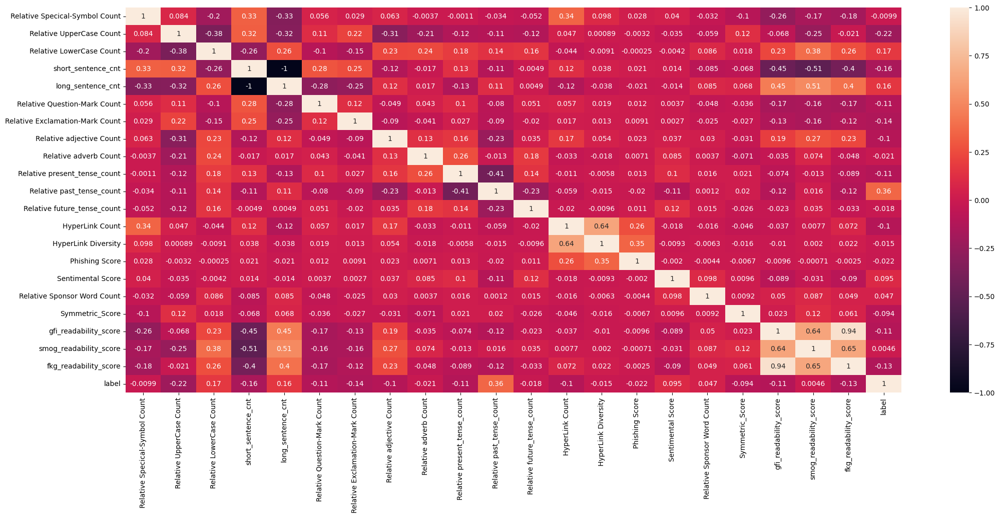

In [ ]:
fig = plt.figure(figsize=(25,10))
heatmap = sns.heatmap(df_train.corr(), annot=True)

In [ ]:
heatmap = heatmap.get_figure()
heatmap.savefig('/content/drive/MyDrive/dataset/data-set-1/data-set-1_heat_dist.png')

### Train Model

In [74]:
df_train = df.iloc[:,2:]
df_train.head()

,Number of Words,Number of character,Number of Specical-Symbol,Relative Specical-Symbol Count,Number of UpperCase,Relative UpperCase Count,Number of LowerCase,Relative LowerCase Count,short_sentence_cnt,long_sentence_cnt,...,HyperLink Diversity,Phishing Score,Sentimental Score,Sponsor Word Count,Relative Sponsor Word Count,Symmetric_Score,gfi_readability_score,smog_readability_score,fkg_readability_score,label
0,834,5021,89,0.017726,224,0.044613,3799,0.756622,0.205128,0.794872,...,0,0,0.1531,1,0.001199,0.498815,11.76,12.2,10.6,0
1,719,4215,73,0.017319,116,0.027521,3212,0.762040,0.272727,0.727273,...,0,0,-0.7112,2,0.002782,0.268717,11.63,11.9,10.3,1
2,1273,7747,180,0.023235,232,0.029947,5946,0.767523,0.259259,0.740741,...,0,0,0.9949,5,0.003928,0.156456,11.39,12.9,10.8,0
3,567,3312,51,0.015399,140,0.042271,2486,0.750604,0.250000,0.750000,...,0,0,-0.9993,3,0.005291,0.420980,11.23,11.7,9.4,0
4,168,1035,16,0.015459,22,0.021256,807,0.779710,0.000000,1.000000,...,0,0,-0.9753,0,0.000000,0.458664,14.82,13.6,13.9,0


In [ ]:
df_train.corr()

In [77]:
X_1 = df_train.drop(columns=['label'])
Y_1= df_train['label']

In [78]:
df_train.shape

(26538, 35)

In [79]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26538 entries, 0 to 26537
Data columns (total 35 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Number of Words                  26538 non-null  int64  
 1   Number of character              26538 non-null  int64  
 2   Number of Specical-Symbol        26538 non-null  int64  
 3   Relative Specical-Symbol Count   26538 non-null  float64
 4   Number of UpperCase              26538 non-null  int64  
 5   Relative UpperCase Count         26538 non-null  float64
 6   Number of LowerCase              26538 non-null  int64  
 7   Relative LowerCase Count         26538 non-null  float64
 8   short_sentence_cnt               26538 non-null  float64
 9   long_sentence_cnt                26538 non-null  float64
 10  Number of Question-Mark          26538 non-null  int64  
 11  Relative Question-Mark Count     26538 non-null  float64
 12  Number of Exclamat

In [80]:
X_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26538 entries, 0 to 26537
Data columns (total 34 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Number of Words                  26538 non-null  int64  
 1   Number of character              26538 non-null  int64  
 2   Number of Specical-Symbol        26538 non-null  int64  
 3   Relative Specical-Symbol Count   26538 non-null  float64
 4   Number of UpperCase              26538 non-null  int64  
 5   Relative UpperCase Count         26538 non-null  float64
 6   Number of LowerCase              26538 non-null  int64  
 7   Relative LowerCase Count         26538 non-null  float64
 8   short_sentence_cnt               26538 non-null  float64
 9   long_sentence_cnt                26538 non-null  float64
 10  Number of Question-Mark          26538 non-null  int64  
 11  Relative Question-Mark Count     26538 non-null  float64
 12  Number of Exclamat

In [81]:
X_1.shape

(26538, 34)

In [82]:
X_1.sample()

,Number of Words,Number of character,Number of Specical-Symbol,Relative Specical-Symbol Count,Number of UpperCase,Relative UpperCase Count,Number of LowerCase,Relative LowerCase Count,short_sentence_cnt,long_sentence_cnt,...,HyperLink Count,HyperLink Diversity,Phishing Score,Sentimental Score,Sponsor Word Count,Relative Sponsor Word Count,Symmetric_Score,gfi_readability_score,smog_readability_score,fkg_readability_score
23277,542,3245,109,0.03359,101,0.031125,2434,0.750077,0.394737,0.605263,...,0,0,0,-0.9882,0,0.0,0.177751,8.3,9.5,6.8


In [ ]:
df_train.corr()

In [75]:
std_scaler=StandardScaler()

In [83]:
x_train_1,x_test_1,y_train_1,y_test_1=train_test_split(X_1,Y_1,test_size=0.2,random_state=42)
x_train=std_scaler.fit_transform(x_train_1)
x_test=std_scaler.transform(x_test_1)

####Result train -test accuracy metrics

In [ ]:
test_size=[0.2,0.3,0.33,0.4]
acc_score_all_1=[]
acc_score_t_all_1=[]
for i  in test_size:
  x_train_1,x_test_1,y_train_1,y_test_1=train_test_split(X_1,Y_1,test_size=i,random_state=42)
  x_train_1=std_scaler.fit_transform(x_train_1)
  x_test_1=std_scaler.transform(x_test_1)
  acc_score_t_1,acc_score_1=model_helper(x_train_1,x_test_1,y_train_1,y_test_1)
  acc_score_t_all_1.append(acc_score_t_1)
  acc_score_all_1.append(acc_score_1)

In [ ]:
print(acc_score_all_1)
print(acc_score_t_all_1)

[[0.7663903541823662, 0.807648831951771, 0.8415599095704597, 0.7669555388093444], [0.7607385079125848, 0.8001758352172821, 0.8324541572469228, 0.7606129113288118], [0.7615894039735099, 0.7991550582324731, 0.8291847453756566, 0.7586206896551724], [0.7617746797287114, 0.79879427279578, 0.8227204220045214, 0.7575357950263752]]
[[0.760197833254828, 0.8110692416391898, 1.0, 0.7814413565708902], [0.7625430663221361, 0.8122308354866494, 0.9999461670973299, 0.7840762273901809], [0.761867266591676, 0.8124859392575928, 1.0, 0.7807649043869517], [0.7617761587740234, 0.8107649792739605, 1.0, 0.7779173470669514]]


In [ ]:
acc_score_t_all_1=np.array(acc_score_t_all_1)
acc_score_t_all_1=np.transpose(acc_score_t_all_1)
acc_score_t_all_df_1=pd.DataFrame(acc_score_t_all_1,columns=['20% Train Data','30% Train Data','33% Train Data','40% Train Data'])
acc_score_t_all_df_1['Model']=['Logistic Regrssion','Support vector class','Random Forest','K-Nearest Neighbour']
acc_score_t_all_df_1.head()

,20% Train Data,30% Train Data,33% Train Data,40% Train Data,Model
0,0.760198,0.762543,0.761867,0.761776,Logistic Regrssion
1,0.811069,0.812231,0.812486,0.810765,Support vector class
2,1.000000,0.999946,1.000000,1.000000,Random Forest
3,0.781441,0.784076,0.780765,0.777917,K-Nearest Neighbour


In [ ]:
acc_score_t_all_df_1.to_csv('/content/drive/MyDrive/dataset/images_ds_1/acc_mat_train.csv')

In [ ]:
acc_score_all_1=np.array(acc_score_all_1)
acc_score_all_1=np.transpose(acc_score_all_1)
acc_score_all_df_1=pd.DataFrame(acc_score_all_1,columns=['20% Test Data','30% Test Data','33% Test Data','40% Test Data'])
acc_score_all_df_1['Model']=['Logistic Regrssion','Support vector class','Random Forest','K-Nearest Neighbour']
acc_score_all_df_1.head()

,20% Test Data,30% Test Data,33% Test Data,40% Test Data,Model
0,0.766390,0.760739,0.761589,0.761775,Logistic Regrssion
1,0.807649,0.800176,0.799155,0.798794,Support vector class
2,0.841560,0.832454,0.829185,0.822720,Random Forest
3,0.766956,0.760613,0.758621,0.757536,K-Nearest Neighbour


In [ ]:
acc_score_all_df_1.to_csv('/content/drive/MyDrive/dataset/images_ds_1/acc_mat_test.csv')

#### standard values

In [86]:
y_test_1.shape

(5308,)

In [ ]:
y_pred_1,ac_t_lr_1,ac_lr_1=model_train(lr,x_train_1,y_train_1,x_test_1,y_test_1)
y_pred_svc_1,ac_t_svc_1,ac_svc_1=model_train(svc_clf,x_train_1,y_train_1,x_test_1,y_test_1)
y_pred_rand_1,ac_t_rand_1,ac_rand_1=model_train(rand_forest,x_train_1,y_train_1,x_test_1,y_test_1)
y_pred_knn_1,ac_t_knn_1,ac_knn_1=model_train(knn,x_train_1,y_train_1,x_test_1,y_test_1)

In [88]:
print('lr score:',ac_lr_1)
print('svc score:',ac_svc_1)
print('random forest score:',ac_rand_1)
print('knn socre:',ac_knn_1)

lr score: 0.7614920874152223
svc score: 0.63413715146948
random forest score: 0.8528636021100227
knn socre: 0.6834966088922382


#### confusion matxics

In [ ]:
SaveConfusionMatrix('logistic_Reg',y_test_1,y_pred_1,'images_ds_1')
SaveConfusionMatrix('svc',y_test_1,y_pred_svc_1,'images_ds_1')
SaveConfusionMatrix('random_forest',y_test_1,y_pred_rand_1,'images_ds_1')
SaveConfusionMatrix('knn',y_test_1,y_pred_knn_1,'images_ds_1')

### precison,recall f1_score

In [89]:
lst_1=[]
lst_1.append(precision_recall_f1_score('Logistic Regression',y_test_1,y_pred_1))
lst_1.append(precision_recall_f1_score('Support vector class',y_test_1,y_pred_svc_1))
lst_1.append(precision_recall_f1_score('Random Forest',y_test_1,y_pred_rand_1))
lst_1.append(precision_recall_f1_score('K-Nearest Neighbour',y_test_1,y_pred_knn_1))

In [90]:
prf=np.array(lst_1)
prf=prf.reshape(4,3)
prf_data=pd.DataFrame(prf,columns=['precision_score','recall_score','F1_score'])
prf_data['model']=['Logistic Regression','SVC','Random Forest','KNN']
prf_data.head()

,precision_score,recall_score,F1_score,model
0,0.761599,0.761025,0.761312,Logistic Regression
1,0.629792,0.650207,0.639837,SVC
2,0.853208,0.852243,0.852725,Random Forest
3,0.666098,0.735394,0.699033,KNN


In [ ]:
prf_data.to_csv('/content/drive/MyDrive/dataset/images_ds_1/prf.csv')

In [ ]:
sns.barplot(prf_data,x='model',y='precision_score',width=0.5)
plt.savefig('/content/drive/MyDrive/dataset/images_ds_1/precision.png')


In [ ]:
sns.barplot(prf_data,x='model',y='recall_score',width=0.5)
plt.savefig('/content/drive/MyDrive/dataset/images_ds_1/recall.png')

In [ ]:
sns.barplot(prf_data,x='model',y='F1_score',width=0.5)
plt.savefig('/content/drive/MyDrive/dataset/images_ds_1/f1.png')

## Data-set-2

### Import Fake.csv

In [ ]:
fake_data=pd.read_csv('/content/drive/MyDrive/dataset/data-set-2/Fake.csv')
fake_data.head()

,title,text,subject,date
0,Donald Trump Sends Out Embarrassing New Year’...,Donald Trump just couldn t wish all Americans ...,News,"December 31, 2017"
1,Drunk Bragging Trump Staffer Started Russian ...,House Intelligence Committee Chairman Devin Nu...,News,"December 31, 2017"
2,Sheriff David Clarke Becomes An Internet Joke...,"On Friday, it was revealed that former Milwauk...",News,"December 30, 2017"
3,Trump Is So Obsessed He Even Has Obama’s Name...,"On Christmas day, Donald Trump announced that ...",News,"December 29, 2017"
4,Pope Francis Just Called Out Donald Trump Dur...,Pope Francis used his annual Christmas Day mes...,News,"December 25, 2017"


In [ ]:
fake_data=fake_data.drop(columns=['subject', 'date'])
fake_data.head()

,title,text
0,Donald Trump Sends Out Embarrassing New Year’...,Donald Trump just couldn t wish all Americans ...
1,Drunk Bragging Trump Staffer Started Russian ...,House Intelligence Committee Chairman Devin Nu...
2,Sheriff David Clarke Becomes An Internet Joke...,"On Friday, it was revealed that former Milwauk..."
3,Trump Is So Obsessed He Even Has Obama’s Name...,"On Christmas day, Donald Trump announced that ..."
4,Pope Francis Just Called Out Donald Trump Dur...,Pope Francis used his annual Christmas Day mes...


In [ ]:
fake_data['label'] = 0
fake_data.head()

,title,text,label
0,Donald Trump Sends Out Embarrassing New Year’...,Donald Trump just couldn t wish all Americans ...,0
1,Drunk Bragging Trump Staffer Started Russian ...,House Intelligence Committee Chairman Devin Nu...,0
2,Sheriff David Clarke Becomes An Internet Joke...,"On Friday, it was revealed that former Milwauk...",0
3,Trump Is So Obsessed He Even Has Obama’s Name...,"On Christmas day, Donald Trump announced that ...",0
4,Pope Francis Just Called Out Donald Trump Dur...,Pope Francis used his annual Christmas Day mes...,0


### Import true.csv

In [ ]:
true_data=pd.read_csv('/content/drive/MyDrive/dataset/data-set-2/True.csv')
true_data.head()

,title,text,subject,date
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,politicsNews,"December 31, 2017"
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,politicsNews,"December 29, 2017"
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,politicsNews,"December 31, 2017"
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,politicsNews,"December 30, 2017"
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,politicsNews,"December 29, 2017"


In [ ]:
true_data=true_data.drop(columns=['subject', 'date'])
true_data.head()

,title,text
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...


In [ ]:
true_data['label'] = 1
true_data.head()

,title,text,label
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,1
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,1
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,1
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,1
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,1


### Concat True and fake

In [ ]:
df_temp_2=[true_data,fake_data]

In [ ]:
df_org_2=pd.concat(df_temp_2,ignore_index=True)
df_org_2.sample(10)

,title,text,label
41153,BERKELEY COLLEGE THUGS Form Human Chain To Sto...,"Students at the University of California, Berk...",0
7857,Trump says he doesn't want House Speaker Ryan'...,WASHINGTON (Reuters) - Donald Trump said on Tu...,1
41141,CLINTON SUPPORTER CARL BERNSTEIN : FBI Found A...,,0
24707,Climate Change Deniers Get A PERFECT New Name...,Legendary news anchor Dan Rather just gave us ...,0
27731,Megyn Kelly Leaves Trump Literally Sputtering...,"After a very public falling out, Megyn Kelly f...",0
16133,"Exclusive: Koran, boots and scarves all that r...","MARAWI CITY, Philippines (Reuters) - Prayer ma...",1
25931,"Good News Folks, God Is Now Protecting Donald...",Were you worried that Donald Trump might fall ...,0
36548,HILLARY’S BIGGEST GUN CONTROL FAN LET’S LOOSE ...,Are there any real men left in the Democrat pa...,0
10067,House ethics committee continues probe of Flor...,WASHINGTON (Reuters) - The ethics committee of...,1
41210,HILLARY’S THUGS Spray Paint 20 Cars Outside Tr...,Several attendees left Republican presidential...,0


In [ ]:
df_features_2=df_org_2.drop(columns=['label'])
df_features_2.head()

,title,text
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...


###  Adding Features

In [ ]:
### Feature Extraction
    ## Complexity Features
        # 01. total_word_cnt <-
        # 02. total_char_cnt <-
        # 03. special_character <-
        # 04. upper_case <-
        # 05. lower_case <-
        # 06. short_sentences <-
        # 07. long_sentences <-
        # 08. question_marks <-
        # 09. exclamation_marks <-
    ## Stylometric Features
        # 10. adjective_count <-
        # 11. adverb_count <-
        # 12. present_tense_cnt <-
        # 13. past_tense_cnt <-
        # 14. future_tense_cnt <-
    ## 
        # 15. hyperlinks <-
        # 16. hyperlinks_diversity <-
        # 17. phising_score <-
        # 18. sensational_score <-
        # 19. sponsorship_score <-
        # 20. headline_content_symmetry_score <-
        # 21. gfi_readability_score <-
        # 22. smog_readability_score <-
        # 23. fkg_readability_score <-

#### Number of words

In [ ]:
df_features_2["Number of Words"] = df_features_2.apply(lambda x: total_word_cnt_fe(x['text'],x['title']),axis=1)
df_features_2["Number of character"] = df_features_2.apply(lambda x: total_char_cnt_fe(x['text'],x['title']),axis=1)

#### Number of Specical-Symbol

In [ ]:
df_features_2['Number of Specical-Symbol'] = df_features_2.apply(lambda x:special_character_fe(x['text'],x['title']),axis=1)
df_features_2['Relative Specical-Symbol Count'] = df_features_2['Number of Specical-Symbol']/df_features_2["Number of character"]

#### Number of UpperCase

In [ ]:
df_features_2['Number of UpperCase'] = df_features_2.apply(lambda x:upper_case_fe(x['text'],x['title']),axis=1)
df_features_2['Relative UpperCase Count'] = df_features_2['Number of UpperCase']/df_features_2["Number of character"]

#### Number of LowerCase

In [ ]:
df_features_2['Number of LowerCase'] = df_features_2.apply(lambda x:lower_case_fe(x['text'],x['title']),axis=1)
df_features_2['Relative LowerCase Count'] = df_features_2['Number of LowerCase']/df_features_2["Number of character"]

#### short_sentence_cnt long_sentence_cnt

In [ ]:
df_features_2[['short_sentence_cnt', 'long_sentence_cnt']] = df_features_2.apply(lambda x:length_sentences_fe(content = x['text'], headline = x['title']), axis=1)

#### Number of Question-Mark

In [ ]:
df_features_2['Number of Question-Mark'] = df_features_2.apply(lambda x:question_marks_fe(x['text'],x['title']),axis=1)
df_features_2['Relative Question-Mark Count'] = df_features_2['Number of Question-Mark']/df_features_2["Number of character"]

#### Number of Exclamation-Mark

In [ ]:
df_features_2['Number of Exclamation-Mark'] = df_features_2.apply(lambda x:exclamation_marks_fe(x['text'],x['title']),axis=1)
df_features_2['Relative Exclamation-Mark Count'] = df_features_2['Number of Exclamation-Mark']/df_features_2["Number of character"]

#### Adjective and Adverb Count

In [ ]:
df_features_2[['adjective_cnt', 'adverb_cnt']] = df_features_2.apply(lambda x:adj_and_adv_count_fe(content = x['text'], headline = x['title']), axis=1)

In [ ]:
df_features_2[['adjective_cnt', 'adverb_cnt']] = df_features_2.apply(lambda x:adj_and_adv_count_fe(content = x['text'], headline = x['title']), axis=1)
df_features_2['Relative adjective Count'] = df_features_2['adjective_cnt']/df_features_2["Number of Words"]
df_features_2['Relative adverb Count'] = df_features_2['adverb_cnt']/df_features_2["Number of Words"]

#### Hyperlinks

In [ ]:
df_features_2[['HyperLink Count', 'HyperLink Diversity', 'Phishing Score']] = df_features_2.apply(lambda x:hyperlinks_fe(content = x['text'], headline = x['title']), axis=1)

#### Sentimental Score

In [ ]:
df_features_2['Sentimental Score'] = df_features_2.apply(lambda x:sentimental_score_fe(x['text'],x['title']),axis=1)

#### Sponsor Word Count

In [ ]:
df_features_2['Sponsor Word Count'] = df_features_2.apply(lambda x:sponsorship_score_fe(content = x['text'], headline = x['title']), axis=1)
df_features_2['Relative Sponsor Word Count'] = df_features_2['Sponsor Word Count']/df_features_2["Number of Words"]

#### Symmetric_Score

In [ ]:
df_features_2['Symmetric_Score'] = df_features_2.apply(lambda x: headline_content_symmetry_score_fe(content = x['text'], headline = x['title']), axis=1)


#### Readability Score

In [ ]:
df_features_2[['gfi_readability_score', 'smog_readability_score', 'fkg_readability_score']] = df_features_2.apply(lambda x:readability_score_fe(content = x['text'], headline = x['title']), axis=1)

#### Tense_Score

In [ ]:
df_features_2[['present_tense_count', 'past_tense_count', 'future_tense_count']] = df_features_2.apply(lambda x:tense_score_fe(content = x['text'], headline = x['title']), axis=1)

In [ ]:
#df_features_2[['present_tense_count', 'past_tense_count', 'future_tense_count']] = df_features_2.apply(lambda x:tense_score_fe(content = x['text'], headline = x['title']), axis=1)
df_features_2['Relative present_tense_count'] = df_features_2['present_tense_count']/df_features_2["Number of Words"]
df_features_2['Relative past_tense_count'] = df_features_2['past_tense_count']/df_features_2["Number of Words"]
df_features_2['Relative future_tense_count'] = df_features_2['future_tense_count']/df_features_2["Number of Words"]

#### Save to drive

In [ ]:
df_features_2.head()

,title,text,Number of Words,Number of character,Number of Specical-Symbol,Relative Specical-Symbol Count,Number of UpperCase,Relative UpperCase Count,Number of LowerCase,Relative LowerCase Count,...,Symmetric_Score,gfi_readability_score,smog_readability_score,fkg_readability_score,present_tense_count,past_tense_count,future_tense_count,Relative present_tense_count,Relative past_tense_count,Relative future_tense_count
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,759,4723,121,0.025619,159,0.033665,3615,0.765403,...,0.252640,10.99,12.5,10.9,31,28,11,0.040843,0.036891,0.014493
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,633,4141,80,0.019319,123,0.029703,3266,0.788698,...,0.355829,12.45,15.0,12.2,19,30,14,0.030016,0.047393,0.022117
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,467,2849,53,0.018603,124,0.043524,2172,0.762373,...,0.184787,11.64,12.6,10.0,18,30,7,0.038544,0.064240,0.014989
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,385,2520,53,0.021032,118,0.046825,1943,0.771032,...,0.172774,11.43,13.0,10.8,12,32,1,0.031169,0.083117,0.002597
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,863,5273,136,0.025792,204,0.038688,3978,0.754409,...,0.476795,9.52,11.2,8.6,49,27,3,0.056779,0.031286,0.003476


In [ ]:
df_features_2['label']=df_org_2.iloc[:,-1:]
df_features_2.head()

,title,text,Number of Words,Number of character,Number of Specical-Symbol,Relative Specical-Symbol Count,Number of UpperCase,Relative UpperCase Count,Number of LowerCase,Relative LowerCase Count,...,gfi_readability_score,smog_readability_score,fkg_readability_score,present_tense_count,past_tense_count,future_tense_count,Relative present_tense_count,Relative past_tense_count,Relative future_tense_count,label
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,759,4723,121,0.025619,159,0.033665,3615,0.765403,...,10.99,12.5,10.9,31,28,11,0.040843,0.036891,0.014493,1
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,633,4141,80,0.019319,123,0.029703,3266,0.788698,...,12.45,15.0,12.2,19,30,14,0.030016,0.047393,0.022117,1
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,467,2849,53,0.018603,124,0.043524,2172,0.762373,...,11.64,12.6,10.0,18,30,7,0.038544,0.064240,0.014989,1
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,385,2520,53,0.021032,118,0.046825,1943,0.771032,...,11.43,13.0,10.8,12,32,1,0.031169,0.083117,0.002597,1
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,863,5273,136,0.025792,204,0.038688,3978,0.754409,...,9.52,11.2,8.6,49,27,3,0.056779,0.031286,0.003476,1


In [ ]:
df_features_2.shape

(44898, 37)

In [ ]:
df_features_2.to_csv('/content/drive/MyDrive/dataset/data-set-2/with-37-features.csv')


### Feature Selection

In [91]:
df_2=pd.read_csv('/content/drive/MyDrive/dataset/data-set-2/with-37-features.csv')
df_2 = df_2.drop(columns=['Unnamed: 0'])
df_2.head()

,title,text,Number of Words,Number of character,Number of Specical-Symbol,Relative Specical-Symbol Count,Number of UpperCase,Relative UpperCase Count,Number of LowerCase,Relative LowerCase Count,...,gfi_readability_score,smog_readability_score,fkg_readability_score,present_tense_count,past_tense_count,future_tense_count,Relative present_tense_count,Relative past_tense_count,Relative future_tense_count,label
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,759,4723,121,0.025619,159,0.033665,3615,0.765403,...,10.99,12.5,10.9,31,28,11,0.040843,0.036891,0.014493,1
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,633,4141,80,0.019319,123,0.029703,3266,0.788698,...,12.45,15.0,12.2,19,30,14,0.030016,0.047393,0.022117,1
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,467,2849,53,0.018603,124,0.043524,2172,0.762373,...,11.64,12.6,10.0,18,30,7,0.038544,0.064240,0.014989,1
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,385,2520,53,0.021032,118,0.046825,1943,0.771032,...,11.43,13.0,10.8,12,32,1,0.031169,0.083117,0.002597,1
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,863,5273,136,0.025792,204,0.038688,3978,0.754409,...,9.52,11.2,8.6,49,27,3,0.056779,0.031286,0.003476,1


In [ ]:
df_2.shape

(44898, 37)

In [94]:
df_2=df_2.drop(columns=['Number of Words','Number of character', 'Number of Specical-Symbol', 'Number of UpperCase', 'Number of LowerCase', 'Number of Question-Mark', 'Number of Exclamation-Mark', 'Sponsor Word Count', 'adjective_cnt', 'adverb_cnt', 'present_tense_count', 'past_tense_count', 'future_tense_count'])
df_2.head()

,title,text,Relative Specical-Symbol Count,Relative UpperCase Count,Relative LowerCase Count,short_sentence_cnt,long_sentence_cnt,Relative Question-Mark Count,Relative Exclamation-Mark Count,Relative adjective Count,...,Sentimental Score,Relative Sponsor Word Count,Symmetric_Score,gfi_readability_score,smog_readability_score,fkg_readability_score,Relative present_tense_count,Relative past_tense_count,Relative future_tense_count,label
0,"As U.S. budget fight looms, Republicans flip t...",WASHINGTON (Reuters) - The head of a conservat...,0.025619,0.033665,0.765403,0.264706,0.735294,0.00000,0.00000,0.077734,...,0.9843,0.005270,0.252640,10.99,12.5,10.9,0.040843,0.036891,0.014493,1
1,U.S. military to accept transgender recruits o...,WASHINGTON (Reuters) - Transgender people will...,0.019319,0.029703,0.788698,0.375000,0.625000,0.00000,0.00000,0.091627,...,0.1501,0.003160,0.355829,12.45,15.0,12.2,0.030016,0.047393,0.022117,1
2,Senior U.S. Republican senator: 'Let Mr. Muell...,WASHINGTON (Reuters) - The special counsel inv...,0.018603,0.043524,0.762373,0.250000,0.750000,0.00000,0.00000,0.059957,...,-0.6808,0.002141,0.184787,11.64,12.6,10.0,0.038544,0.064240,0.014989,1
3,FBI Russia probe helped by Australian diplomat...,WASHINGTON (Reuters) - Trump campaign adviser ...,0.021032,0.046825,0.771032,0.222222,0.777778,0.00000,0.00000,0.080519,...,-0.2201,0.000000,0.172774,11.43,13.0,10.8,0.031169,0.083117,0.002597,1
4,Trump wants Postal Service to charge 'much mor...,SEATTLE/WASHINGTON (Reuters) - President Donal...,0.025792,0.038688,0.754409,0.295455,0.704545,0.00019,0.00019,0.076477,...,0.8055,0.000000,0.476795,9.52,11.2,8.6,0.056779,0.031286,0.003476,1


In [ ]:
# df_2.to_csv('/content/drive/MyDrive/dataset/data-set-2/with-selected-24-features.csv')


### Graph and plot

In [ ]:
# df_2=pd.read_csv('/content/drive/MyDrive/dataset/data-set-2/with-selected-24-features.csv')
# df_2 = df_2.drop(columns=['Unnamed: 0'])
df_2.head()

,title,text,Relative Specical-Symbol Count,Relative UpperCase Count,Relative LowerCase Count,short_sentence_cnt,long_sentence_cnt,Relative Question-Mark Count,Relative Exclamation-Mark Count,Relative adjective Count,...,HyperLink Count,HyperLink Diversity,Phishing Score,Sentimental Score,Relative Sponsor Word Count,Symmetric_Score,gfi_readability_score,smog_readability_score,fkg_readability_score,label
0,House Dem Aide: We Didn’t Even See Comey’s Let...,House Dem Aide: We Didn’t Even See Comey’s Let...,0.017726,0.044613,0.756622,0.205128,0.794872,0.000000,0.0,0.070743,...,0,0,0,0.1531,0.001199,0.498815,11.76,12.2,10.6,0
1,"FLYNN: Hillary Clinton, Big Woman on Campus - ...",Ever get the feeling your life circles the rou...,0.017319,0.027521,0.762040,0.272727,0.727273,0.000949,0.0,0.082058,...,0,0,0,-0.7112,0.002782,0.268717,11.63,11.9,10.3,1
2,Why the Truth Might Get You Fired,"Why the Truth Might Get You Fired October 29, ...",0.023235,0.029947,0.767523,0.259259,0.740741,0.000516,0.0,0.084839,...,0,0,0,0.9949,0.003928,0.156456,11.39,12.9,10.8,0
3,15 Civilians Killed In Single US Airstrike Hav...,Videos 15 Civilians Killed In Single US Airstr...,0.015399,0.042271,0.750604,0.250000,0.750000,0.000000,0.0,0.072310,...,0,0,0,-0.9993,0.005291,0.420980,11.23,11.7,9.4,0
4,Iranian woman jailed for fictional unpublished...,Print \r\nAn Iranian woman has been sentenced ...,0.015459,0.021256,0.779710,0.000000,1.000000,0.000000,0.0,0.083333,...,0,0,0,-0.9753,0.000000,0.458664,14.82,13.6,13.9,0


In [ ]:
df_train_2=df_2.iloc[:,2:]
df_train_2.head()

,Number of Words,Relative Specical-Symbol Count,Relative UpperCase Count,Relative LowerCase Count,short_sentence_cnt,long_sentence_cnt,Relative Question-Mark Count,Relative Exclamation-Mark Count,Relative adjective Count,Relative adverb Count,...,HyperLink Count,HyperLink Diversity,Phishing Score,Sentimental Score,Relative Sponsor Word Count,Symmetric_Score,gfi_readability_score,smog_readability_score,fkg_readability_score,label
0,834,0.017726,0.044613,0.756622,0.205128,0.794872,0.000000,0.0,0.070743,0.039568,...,0,0,0,0.1531,0.001199,0.498815,11.76,12.2,10.6,0
1,719,0.017319,0.027521,0.762040,0.272727,0.727273,0.000949,0.0,0.082058,0.041725,...,0,0,0,-0.7112,0.002782,0.268717,11.63,11.9,10.3,1
2,1273,0.023235,0.029947,0.767523,0.259259,0.740741,0.000516,0.0,0.084839,0.044776,...,0,0,0,0.9949,0.003928,0.156456,11.39,12.9,10.8,0
3,567,0.015399,0.042271,0.750604,0.250000,0.750000,0.000000,0.0,0.072310,0.017637,...,0,0,0,-0.9993,0.005291,0.420980,11.23,11.7,9.4,0
4,168,0.015459,0.021256,0.779710,0.000000,1.000000,0.000000,0.0,0.083333,0.017857,...,0,0,0,-0.9753,0.000000,0.458664,14.82,13.6,13.9,0


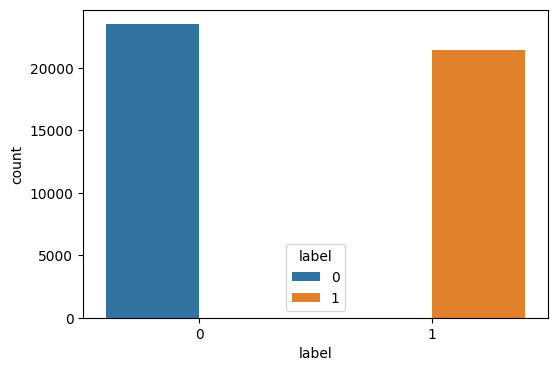

In [ ]:
f_2 = plt.figure()
f_2.set_figwidth(6)
f_2.set_figheight(4)
data_dist_2=sns.countplot(df_2, x='label', hue='label')
plt.savefig('/content/drive/MyDrive/dataset/data-set-2/data_dist_2.png')

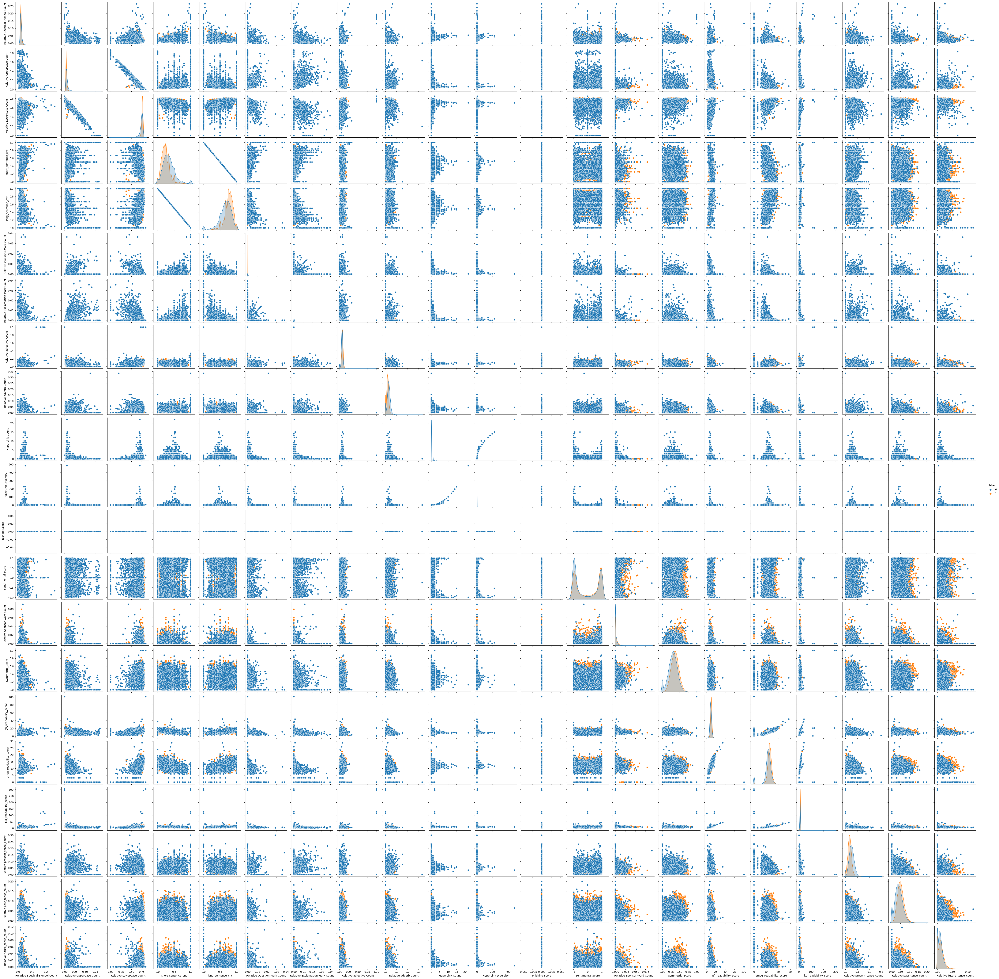

In [ ]:
pairplt_2=sns.pairplot(df_train_2,hue='label')

In [ ]:
pairplt_2.savefig('/content/drive/MyDrive/dataset/data-set-2/data-set-2_pair_dist.png')

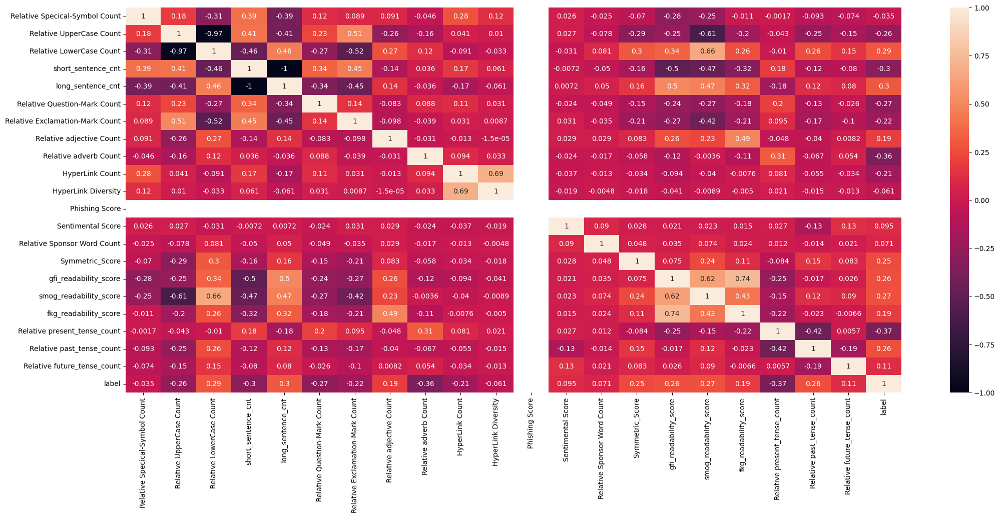

In [ ]:
fig = plt.figure(figsize=(25,10))
heatmap_2 = sns.heatmap(df_train_2.corr(), annot=True)

In [ ]:
heatmap_2 = heatmap_2.get_figure()
heatmap_2.savefig('/content/drive/MyDrive/dataset/data-set-2/data-set-2_heat_dist.png')

### Train Model

In [95]:
df_train_2=df_2.iloc[:,2:]
df_train_2.head()

,Relative Specical-Symbol Count,Relative UpperCase Count,Relative LowerCase Count,short_sentence_cnt,long_sentence_cnt,Relative Question-Mark Count,Relative Exclamation-Mark Count,Relative adjective Count,Relative adverb Count,HyperLink Count,...,Sentimental Score,Relative Sponsor Word Count,Symmetric_Score,gfi_readability_score,smog_readability_score,fkg_readability_score,Relative present_tense_count,Relative past_tense_count,Relative future_tense_count,label
0,0.025619,0.033665,0.765403,0.264706,0.735294,0.00000,0.00000,0.077734,0.028986,0,...,0.9843,0.005270,0.252640,10.99,12.5,10.9,0.040843,0.036891,0.014493,1
1,0.019319,0.029703,0.788698,0.375000,0.625000,0.00000,0.00000,0.091627,0.012638,0,...,0.1501,0.003160,0.355829,12.45,15.0,12.2,0.030016,0.047393,0.022117,1
2,0.018603,0.043524,0.762373,0.250000,0.750000,0.00000,0.00000,0.059957,0.014989,0,...,-0.6808,0.002141,0.184787,11.64,12.6,10.0,0.038544,0.064240,0.014989,1
3,0.021032,0.046825,0.771032,0.222222,0.777778,0.00000,0.00000,0.080519,0.025974,0,...,-0.2201,0.000000,0.172774,11.43,13.0,10.8,0.031169,0.083117,0.002597,1
4,0.025792,0.038688,0.754409,0.295455,0.704545,0.00019,0.00019,0.076477,0.022016,0,...,0.8055,0.000000,0.476795,9.52,11.2,8.6,0.056779,0.031286,0.003476,1


In [ ]:
df_train_2.corr()

In [96]:
X=df_train_2.drop(columns=['label'])
Y=df_train_2['label']

In [ ]:
df_train_2.shape

(44898, 22)

In [ ]:
df_train_2.info()

In [ ]:
X.info()

In [97]:
X.shape

(44898, 21)

In [ ]:
X.sample()

,Relative Specical-Symbol Count,Relative UpperCase Count,Relative LowerCase Count,short_sentence_cnt,long_sentence_cnt,Relative Question-Mark Count,Relative Exclamation-Mark Count,Relative adjective Count,Relative adverb Count,Relative present_tense_count,...,Relative future_tense_count,HyperLink Count,HyperLink Diversity,Phishing Score,Sentimental Score,Relative Sponsor Word Count,Symmetric_Score,gfi_readability_score,smog_readability_score,fkg_readability_score
10393,0.018807,0.027917,0.76844,0.322581,0.677419,0.0,0.0,0.08881,0.023091,0.039076,...,0.010657,0,0,0,0.9532,0.0,0.329529,10.53,12.7,10.0


In [ ]:
df_train_2.corr()

###Train test split of data and Results

In [99]:
std_scaler=StandardScaler()

In [100]:
x_train,x_test,y_train,y_test=train_test_split(X,Y,test_size=0.2,random_state=42)
x_train=std_scaler.fit_transform(x_train)
x_test=std_scaler.transform(x_test)

#### gets predicted values
of test data size of 20,30,33,40 %

In [ ]:
test_size=[0.2,0.3,0.33,0.4]
acc_score_all_2=[]
acc_score_t_all_2=[]
for i  in test_size:
  x_train,x_test,y_train,y_test=train_test_split(X,Y,test_size=i,random_state=42)
  x_train=std_scaler.fit_transform(x_train)
  x_test=std_scaler.transform(x_test)
  acc_score_t_2,acc_score_2=model_helper(x_train,y_train,x_test,y_test)
  acc_score_t_all_2.append(acc_score_t_2)
  acc_score_all_2.append(acc_score_2)

In [ ]:
print(acc_score_t_all_2)
print(acc_score_all_2)

In [ ]:
acc_score_t_all_2=np.array(acc_score_t_all_2)
acc_score_t_all_2=np.transpose(acc_score_t_all_2)
acc_score_t_all_df_2=pd.DataFrame(acc_score_t_all_2,columns=['20% Train Data','30% Train Data','33% Train Data','40% Train Data'])
acc_score_t_all_df_2['Model']=['Logistic Regrssion','Support vector class','Random Forest','K-Nearest Neighbour']
acc_score_t_all_df_2.head()

,20% Train Data,30% Train Data,33% Train Data,40% Train Data,Model
0,0.887911,0.888316,0.888268,0.888856,Logistic Regrssion
1,0.917117,0.917176,0.916592,0.916698,Support vector class
2,0.999972,1.000000,1.000000,1.000000,Random Forest
3,0.876886,0.874920,0.875071,0.875158,K-Nearest Neighbour


In [ ]:
acc_score_t_all_df_2.to_csv('/content/drive/MyDrive/dataset/images_ds_2/acc_score_t_all_df_2.csv')

In [ ]:
acc_score_all_2=np.array(acc_score_all_2)
acc_score_all_2=np.transpose(acc_score_all_2)
acc_score_all_df_2=pd.DataFrame(acc_score_all_2,columns=['20% Test Data','30% Test Data','33% Test Data','40% Test Data'])
acc_score_all_df_2['Model']=['Logistic Regrssion','Support vector class','Random Forest','K-Nearest Neighbour']
acc_score_all_df_2.head()

,20% Test Data,30% Test Data,33% Test Data,40% Test Data,Model
0,0.895212,0.892873,0.892556,0.890757,Logistic Regrssion
1,0.916370,0.916333,0.915367,0.913920,Support vector class
2,0.933073,0.930364,0.927178,0.922996,Random Forest
3,0.862806,0.860059,0.861645,0.861971,K-Nearest Neighbour


In [ ]:
acc_score_all_df_2.to_csv('/content/drive/MyDrive/dataset/images_ds_2/acc_score_all_df_2.csv')

#### get standard score of predicted values i.e 20% of test data 

In [102]:
y_pred_lr_2,ac_t_lr_2,ac_lr_2=model_train(lr,x_train,y_train,x_test,y_test)
y_pred_svc_2,ac_t_svc,ac_svc_2=model_train(svc_clf,x_train,y_train,x_test,y_test)
y_pred_rand_2,ac_t_rand_2,ac_rand_2=model_train(rand_forest,x_train,y_train,x_test,y_test)
y_pred_knn_2,ac_t_knn_2,ac_knn_2=model_train(knn,x_train,y_train,x_test,y_test)

In [103]:
print('lr score:',ac_lr_2)
print('svc score:',ac_svc_2)
print('random forest score:',ac_rand_2)
print('knn socre:',ac_knn_2)

lr score: 0.8952115812917595
svc score: 0.916369710467706
random forest score: 0.9348552338530067
knn socre: 0.8628062360801781


#### confusion matrix graph

In [ ]:
SaveConfusionMatrix('logistic_Reg',y_test,y_pred_lr_2,'images_ds_2')
SaveConfusionMatrix('svc',y_test,y_pred_svc_2,'images_ds_2')
SaveConfusionMatrix('random_forest',y_test,y_pred_rand_2,'images_ds_2')
SaveConfusionMatrix('knn',y_test,y_pred_knn_2,'images_ds_2')

####precision,Recall,F1 score
######Note: belows metics values(Precision, Recall, f1_score)are calculated >by taking 20% of test data

In [ ]:
lst_2=[]
lst_2.append(precision_recall_f1_score('Logistic Regression',y_test,y_pred_lr_2))
lst_2.append(precision_recall_f1_score('Support vector class',y_test,y_pred_svc_2))
lst_2.append(precision_recall_f1_score('Random Forest',y_test,y_pred_rand_2))
lst_2.append(precision_recall_f1_score('K-Nearest Neighbour',y_test,y_pred_knn_2))

Logistic Regression P,R,F1 score are: 0.8690383546414675,0.9088478083943727,0.8884973857694931
Support vector class P,R,F1 score are: 0.8985425375663767,0.9246599232647367,0.9114141645656658
Random Forest P,R,F1 score are: 0.9213038416763679,0.9201255667945588,0.9207143272642663
K-Nearest Neighbour P,R,F1 score are: 0.8250159269483966,0.9033833275200558,0.8624229979466118


In [ ]:
prf_2=np.array(lst_2)

In [ ]:
prf_2=prf_2.reshape(4,3)

In [ ]:
prf_2

array([[0.86966443, 0.91253521, 0.89058419],
       [0.89964452, 0.92676056, 0.91300125],
       [0.92706714, 0.92380282, 0.9254321 ],
       [0.82346913, 0.90535211, 0.86247149]])

In [ ]:
prf_data_2=pd.DataFrame(prf_2,columns=['precision_score','recall_score','F1_score'])

In [ ]:
prf_data_2['model']=['Logistic Regression','SVC','Random Forest','KNN']

In [ ]:
prf_data_2.head()

,precision_score,recall_score,F1_score,model
0,0.741237,0.808319,0.773326,Logistic Regression
1,0.783425,0.828930,0.805535,SVC
2,0.827156,0.819562,0.823341,Random Forest
3,0.721785,0.842421,0.777451,KNN


In [ ]:
prf_data_2.to_csv('/content/drive/MyDrive/dataset/images_ds_2/prf_2.csv')

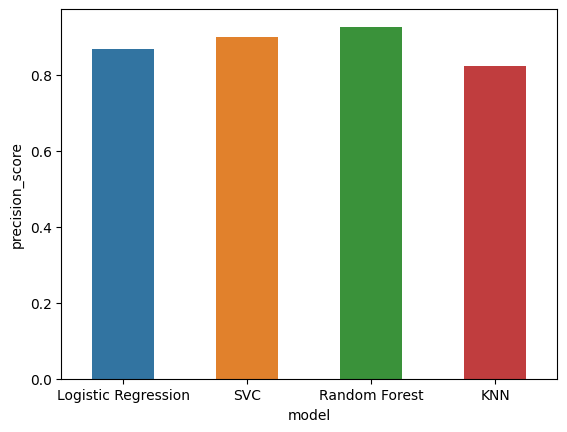

In [ ]:
sns.barplot(prf_data,x='model',y='precision_score',width=0.5)
plt.savefig('/content/drive/MyDrive/dataset/images/precision.png')

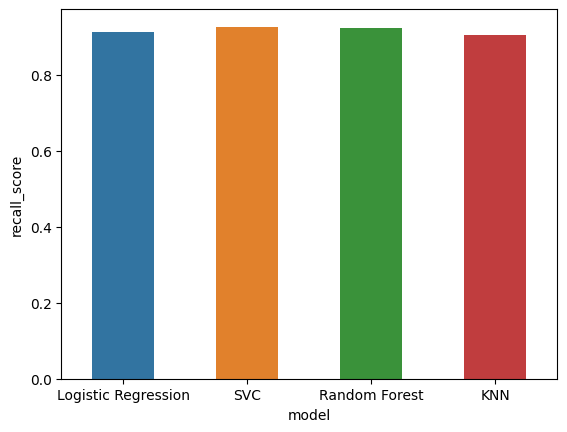

In [ ]:
sns.barplot(prf_data,x='model',y='recall_score',width=0.5)
plt.savefig('/content/drive/MyDrive/dataset/images/recall.png')

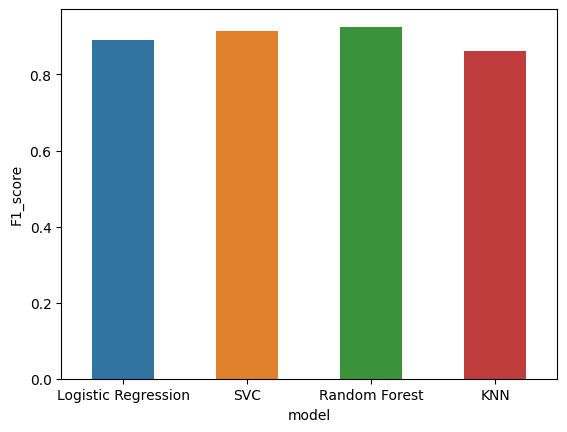

In [ ]:
sns.barplot(prf_data,x='model',y='F1_score',width=0.5)
plt.savefig('/content/drive/MyDrive/dataset/images/f1_score.png')

## DataSet-3

#### import dataset_3

In [ ]:
df_3=pd.read_csv('/content/drive/MyDrive/dataset/dataset_3/RealFake3kDataset.csv')

In [ ]:
df_3.head()

,idd,title,text,label
0,Fq+C96tcx+,‘A target on Roe v. Wade ’: Oklahoma bill maki...,UPDATE: Gov. Fallin vetoed the bill on Friday....,REAL
1,bHUqK!pgmv,Study: women had to drive 4 times farther afte...,Ever since Texas laws closed about half of the...,REAL
2,4Y4Ubf%aTi,"Trump, Clinton clash in dueling DC speeches","Donald Trump and Hillary Clinton, now at the s...",REAL
3,_CoY89SJ@K,Grand jury in Texas indicts activists behind P...,A Houston grand jury investigating criminal al...,REAL
4,+rJHoRQVLe,"As Reproductive Rights Hang In The Balance, De...",WASHINGTON -- Forty-three years after the Supr...,REAL


In [ ]:
# run single time 
df_3.drop('idd',axis=1,inplace=True)

In [ ]:
df_3=df_3.replace({'REAL':1,'FAKE':0})

In [ ]:
df_3.sample(5)

,title,text,label
2225,Blizzard of charges and countercharges melts a...,"This has turned into the whiplash election, an...",1
2413,MSM Caught Preparing Hillary Victory Results P...,MSM Caught Preparing Hillary Victory Results P...,0
2507,The New World Order is melting in the heat of ...,"2013: 7,157 [4] \nVirtually no one in the Zion...",0
899,Marco Rubio’s Crisis of Faith,The Tuesday night before this past Thanksgivin...,1
1650,Memorial Day provides respite from VA controve...,Memorial Day is a time to remember those who g...,1


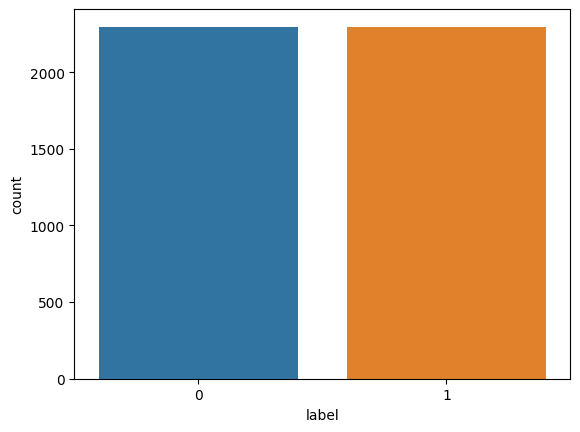

In [ ]:
sns.countplot(df_3,x='label')
plt.savefig('/content/drive/MyDrive/dataset/images_ds_3/cntPltLabel.png')

In [ ]:
df_3.shape

(4594, 3)

In [ ]:
df_3.isnull().sum()

title    1
text     0
label    0
dtype: int64

In [ ]:
df_3=df_3.dropna()

In [ ]:
df_3.isnull().sum()

title    0
text     0
label    0
dtype: int64

In [ ]:
df_features_3=df_3.drop('label',axis=1)

In [ ]:
df_features_3.head()

,title,text
0,‘A target on Roe v. Wade ’: Oklahoma bill maki...,UPDATE: Gov. Fallin vetoed the bill on Friday....
1,Study: women had to drive 4 times farther afte...,Ever since Texas laws closed about half of the...
2,"Trump, Clinton clash in dueling DC speeches","Donald Trump and Hillary Clinton, now at the s..."
3,Grand jury in Texas indicts activists behind P...,A Houston grand jury investigating criminal al...
4,"As Reproductive Rights Hang In The Balance, De...",WASHINGTON -- Forty-three years after the Supr...


#### exctracting features

In [ ]:
df_features_3["Number of Words"] = df_features_3.apply(lambda x: total_word_cnt_fe(x['text'],x['title']),axis=1)
df_features_3["Number of character"] = df_features_3.apply(lambda x: total_char_cnt_fe(x['text'],x['title']),axis=1)

In [ ]:
df_features_3['Number of Specical-Symbol'] =df_features_3.apply(lambda x:special_character_fe(x['text'],x['title']),axis=1)
df_features_3['Relative Specical-Symbol Count'] = df_features_3['Number of Specical-Symbol']/df_features_3["Number of character"]
df_features_3['Number of UpperCase'] = df_features_3.apply(lambda x:upper_case_fe(x['text'],x['title']),axis=1)
df_features_3['Relative UpperCase Count'] = df_features_3['Number of UpperCase']/df_features_3["Number of character"]
df_features_3['Number of LowerCase'] = df_features_3.apply(lambda x:lower_case_fe(x['text'],x['title']),axis=1)
df_features_3['Relative LowerCase Count'] = df_features_3['Number of LowerCase']/df_features_3["Number of character"]
df_features_3[['short_sentence_cnt', 'long_sentence_cnt']] = df_features_3.apply(lambda x:length_sentences_fe(content = x['text'], headline = x['title']), axis=1)
df_features_3['Number of Question-Mark'] = df_features_3.apply(lambda x:question_marks_fe(x['text'],x['title']),axis=1)
df_features_3['Relative Question-Mark Count'] = df_features_3['Number of Question-Mark']/df_features_3["Number of character"]
df_features_3['Number of Exclamation-Mark'] = df_features_3.apply(lambda x:exclamation_marks_fe(x['text'],x['title']),axis=1)
df_features_3['Relative Exclamation-Mark Count'] = df_features_3['Number of Exclamation-Mark']/df_features_3["Number of character"]
df_features_3[['adjective_cnt', 'adverb_cnt']] = df_features_3.apply(lambda x:adj_and_adv_count_fe(content = x['text'], headline = x['title']), axis=1)
df_features_3['Relative adjective Count'] = df_features_3['adjective_cnt']/df_features_3["Number of Words"]
df_features_3['Relative adverb Count'] = df_features_3['adverb_cnt']/df_features_3["Number of Words"]
df_features_3[['HyperLink Count', 'HyperLink Diversity', 'Phishing Score']] = df_features_3.apply(lambda x:hyperlinks_fe(content = x['text'], headline = x['title']), axis=1)
df_features_3['Sentimental Score'] = df_features_3.apply(lambda x:sentimental_score_fe(x['text'],x['title']),axis=1)
df_features_3['Sponsor Word Count'] = df_features_3.apply(lambda x:sponsorship_score_fe(content = x['text'], headline = x['title']), axis=1)
df_features_3['Relative Sponsor Word Count'] = df_features_3['Sponsor Word Count']/df_features_3["Number of Words"]
df_features_3['Symmetric_Score'] = df_features_3.apply(lambda x: headline_content_symmetry_score_fe(content = x['text'], headline = x['title']), axis=1)
df_features_3[['gfi_readability_score', 'smog_readability_score', 'fkg_readability_score']] = df_features_3.apply(lambda x:readability_score_fe(content = x['text'], headline = x['title']), axis=1)
df_features_3[['present_tense_count', 'past_tense_count', 'future_tense_count']] = df_features_3.apply(lambda x:tense_score_fe(content = x['text'], headline = x['title']), axis=1)
df_features_3['Relative present_tense_count'] = df_features_3['present_tense_count']/df_features_3["Number of Words"]
df_features_3['Relative past_tense_count'] = df_features_3['past_tense_count']/df_features_3["Number of Words"]
df_features_3['Relative future_tense_count'] = df_features_3['future_tense_count']/df_features_3["Number of Words"]
print('features extaction completed :)')

features extaction completed :)


In [ ]:
df_features_3.head()

In [ ]:
df_features_3['label']=df_3['label']

In [ ]:
df_features_3.to_csv('/content/drive/MyDrive/dataset/dataset_3/dataset_3With37.csv')

#### selecting features





In [ ]:
df_features_3=pd.read_csv('/content/drive/MyDrive/dataset/dataset_3/dataset_3With37.csv')

In [ ]:
df_features_3.drop('Unnamed: 0',axis=1,inplace=True)

In [ ]:
df_train3=df_features_3.drop(columns=['text','title','Number of Words','Number of character', 'Number of Specical-Symbol', 'Number of UpperCase', 'Number of LowerCase', 'Number of Question-Mark', 'Number of Exclamation-Mark', 'Sponsor Word Count', 'adjective_cnt', 'adverb_cnt', 'present_tense_count', 'past_tense_count', 'future_tense_count'])
df_train3.head()

,Relative Specical-Symbol Count,Relative UpperCase Count,Relative LowerCase Count,short_sentence_cnt,long_sentence_cnt,Relative Question-Mark Count,Relative Exclamation-Mark Count,Relative adjective Count,Relative adverb Count,HyperLink Count,...,Sentimental Score,Relative Sponsor Word Count,Symmetric_Score,gfi_readability_score,smog_readability_score,fkg_readability_score,Relative present_tense_count,Relative past_tense_count,Relative future_tense_count,label
0,0.020183,0.025633,0.773424,0.265306,0.734694,0.000000,0.000000,0.071300,0.026173,0,...,0.9342,0.001805,0.357263,11.71,13.0,10.4,0.055957,0.050542,0.018953,1
1,0.021813,0.018662,0.773146,0.038462,0.961538,0.000000,0.000000,0.093484,0.056657,0,...,-0.8319,0.000000,0.592852,12.39,11.0,11.1,0.033994,0.065156,0.007082,1
2,0.023214,0.024420,0.774797,0.285714,0.714286,0.000301,0.000603,0.111954,0.028463,0,...,0.8212,0.009488,0.427596,11.65,12.3,9.4,0.032258,0.074004,0.017078,1
3,0.019681,0.025808,0.795767,0.243243,0.756757,0.000000,0.000000,0.080194,0.026731,0,...,0.4191,0.002430,0.427609,13.98,14.8,13.6,0.034022,0.064399,0.012151,1
4,0.022669,0.034735,0.772943,0.352941,0.647059,0.000000,0.000000,0.079186,0.024887,0,...,0.8968,0.004525,0.244768,13.26,12.7,12.2,0.049774,0.020362,0.011312,1


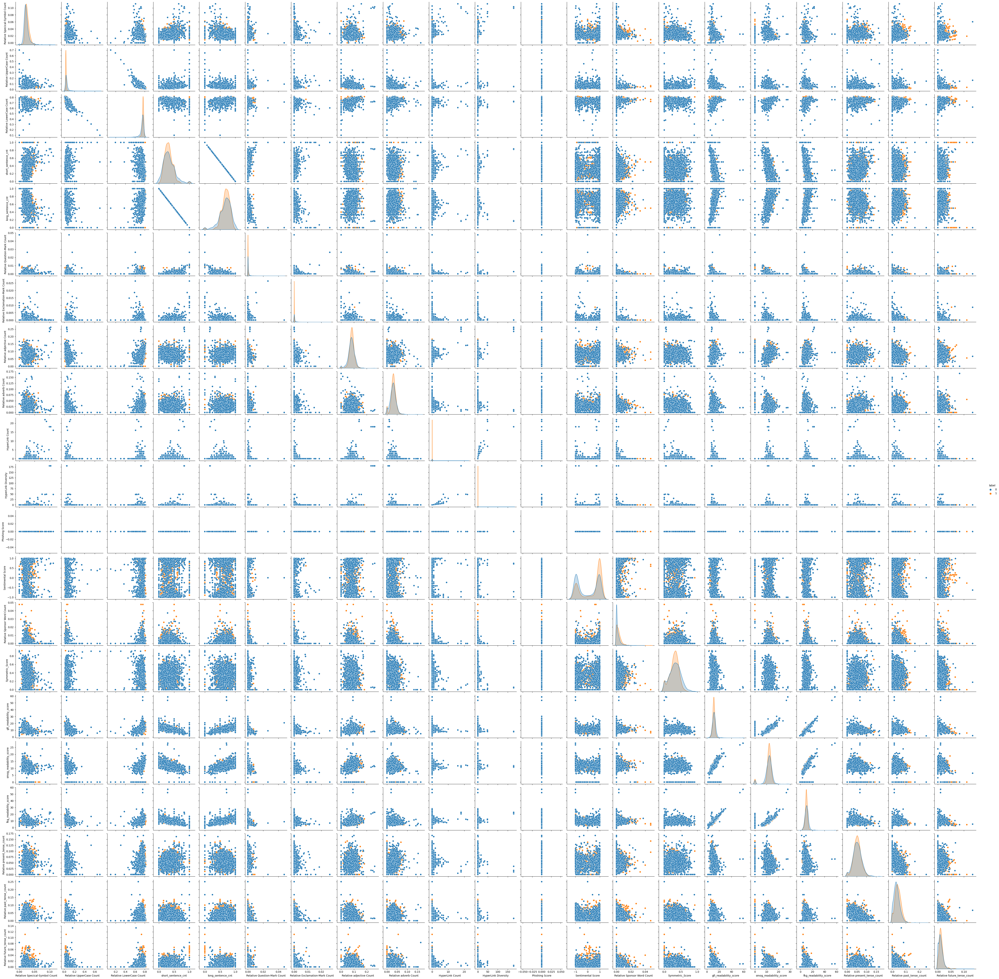

In [ ]:
df3_pairplot=sns.pairplot(df_train3,hue='label')
plt.savefig('/content/drive/MyDrive/dataset/images_ds_3/df3_pairplot.png')

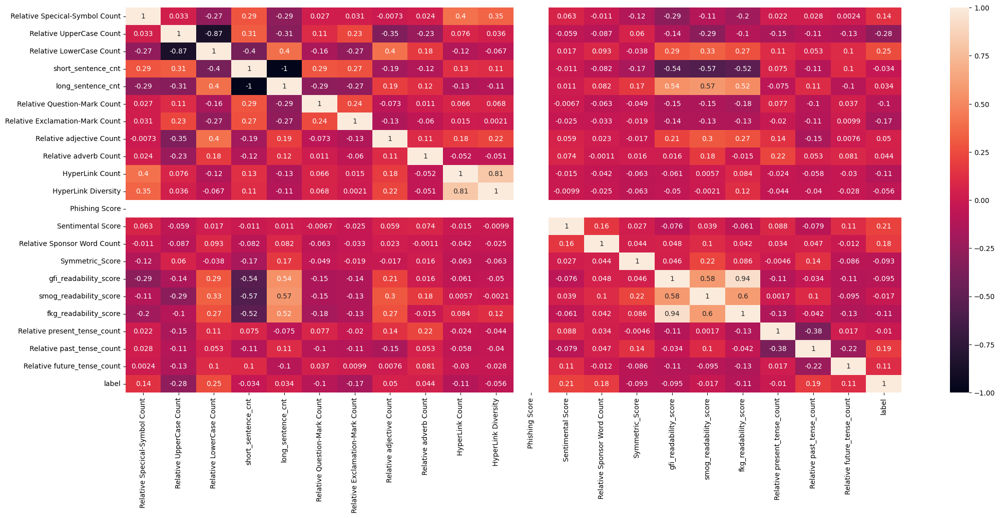

In [ ]:
plt.figure(figsize=(25,10))
df3_heatmap=sns.heatmap(df_train3.corr(),annot=True)
plt.savefig('/content/drive/MyDrive/dataset/images_ds_3/df3_heatmap.png')

In [ ]:
df_train3.shape

(4593, 22)

In [ ]:
X_3=df_train3.iloc[:,:-1]
Y_3=df_train3['label']

In [ ]:
X_3.shape

(4593, 21)

In [ ]:
std_scaler=StandardScaler()

In [ ]:
x_train_3,x_test_3,y_train_3,y_test_3=train_test_split(X_3,Y_3,test_size=0.2,random_state=42)

In [ ]:
x_train_3=std_scaler.fit_transform(x_train_3)
x_test_3=std_scaler.transform(x_test_3)

In [ ]:
x_train_3.shape

(2755, 21)

In [ ]:
y_test_3.shape

(1838,)

In [ ]:
x_test_3.shape

(1838, 21)

####Result train -test accuracy metrics

In [ ]:
test_size=[0.2,0.3,0.33,0.4]
acc_score_all=[]
acc_score_t_all=[]
for i  in test_size:
  x_train_3,x_test_3,y_train_3,y_test_3=train_test_split(X,Y,test_size=i,random_state=42)
  x_train_3=std_scaler.fit_transform(x_train_3)
  x_test_3=std_scaler.transform(x_test_3)
  acc_score_t,acc_score=model_helper(x_train_3,x_test_3,y_train_3,y_test_3)
  acc_score_t_all.append(acc_score_t)
  acc_score_all.append(acc_score)

In [ ]:
print(acc_score_all)
print(acc_score_t_all)

[[0.7834602829162133, 0.8150163220892275, 0.8269858541893362, 0.7769314472252449], [0.772133526850508, 0.8178519593613933, 0.8142235123367199, 0.7561683599419449], [0.7803430079155673, 0.8218997361477572, 0.8199208443271768, 0.7506596306068601], [0.7899891186071817, 0.8258977149075082, 0.8280739934711643, 0.7546245919477693]]
[[0.7972237343494829, 0.854109961894393, 1.0, 0.7879695155144257], [0.7950233281493001, 0.8538102643856921, 1.0, 0.7847589424572318], [0.7962300942476438, 0.8531036724081899, 1.0, 0.7848553786155346], [0.7952813067150635, 0.8526315789473684, 1.0, 0.7814882032667877]]


In [ ]:
acc_score_t_all=np.array(acc_score_t_all)
acc_score_t_all=np.transpose(acc_score_t_all)
acc_score_t_all_df=pd.DataFrame(acc_score_t_all,columns=['20% Train Data','30% Train Data','33% Train Data','40% Train Data'])
acc_score_t_all_df['Model']=['Logistic Regrssion','Support vector class','Random Forest','K-Nearest Neighbour']
acc_score_t_all_df.head()

,20% Train Data,30% Train Data,33% Train Data,40% Train Data,Model
0,0.797224,0.795023,0.796230,0.795281,Logistic Regrssion
1,0.854110,0.853810,0.853104,0.852632,Support vector class
2,1.000000,1.000000,1.000000,1.000000,Random Forest
3,0.787970,0.784759,0.784855,0.781488,K-Nearest Neighbour


In [ ]:
acc_score_t_all_df.to_csv('/content/drive/MyDrive/dataset/images_ds_3/acc_train.csv')

In [ ]:
acc_score_all=np.array(acc_score_all)
acc_score_all=np.transpose(acc_score_all)
acc_score_all_df=pd.DataFrame(acc_score_all,columns=['20% Test Data','30% Test Data','33% Test Data','40% Test Data'])
acc_score_all_df['Model']=['Logistic Regrssion','Support vector class','Random Forest','K-Nearest Neighbour']
acc_score_all_df.head()

,20% Test Data,30% Test Data,33% Test Data,40% Test Data,Model
0,0.783460,0.772134,0.780343,0.789989,Logistic Regrssion
1,0.815016,0.817852,0.821900,0.825898,Support vector class
2,0.826986,0.814224,0.819921,0.828074,Random Forest
3,0.776931,0.756168,0.750660,0.754625,K-Nearest Neighbour


In [ ]:
acc_score_all_df.to_csv('/content/drive/MyDrive/dataset/images_ds_3/acc_test.csv')

#### standard values

In [ ]:
y_pred,ac_t_lr,ac_lr=model_train(lr,x_train,y_train,x_test,y_test)
y_pred_svc,ac_t_svc,ac_svc=model_train(svc_clf,x_train,y_train,x_test,y_test)
y_pred_rand,ac_t_rand,ac_rand=model_train(rand_forest,x_train,y_train,x_test,y_test)
y_pred_knn,ac_t_knn,ac_knn=model_train(knn,x_train,y_train,x_test,y_test)

In [ ]:
print('lr score:',ac_lr)
print('svc score:',ac_svc)
print('random forest score:',ac_rand)
print('knn socre:',ac_knn)

lr score: 0.7899891186071817
svc score: 0.8258977149075082
random forest score: 0.8258977149075082
knn socre: 0.7546245919477693


#### confusion matxics

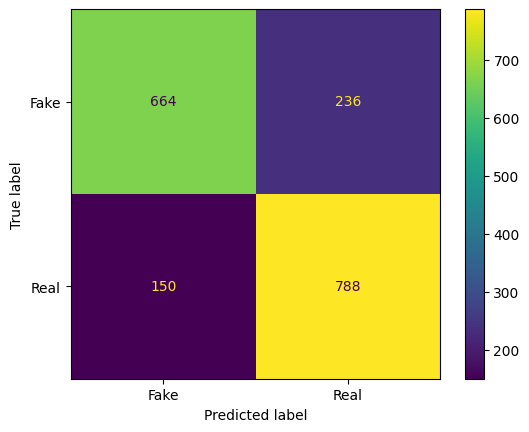

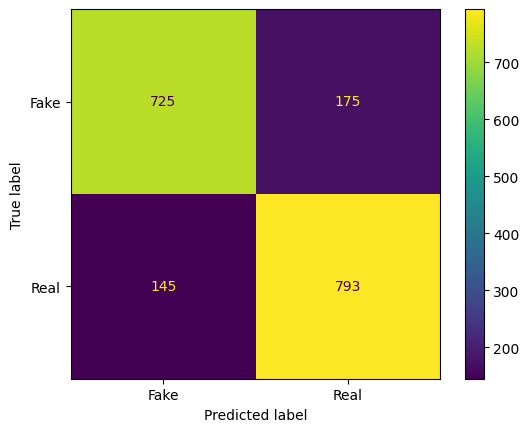

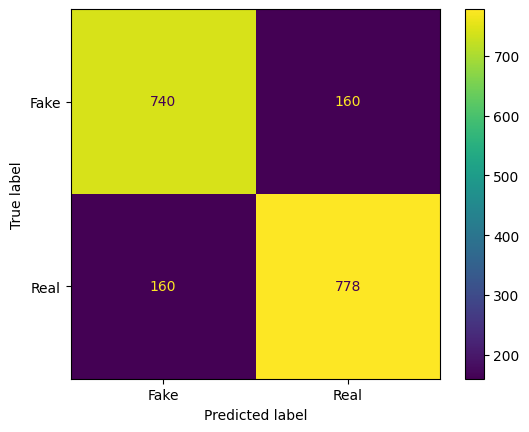

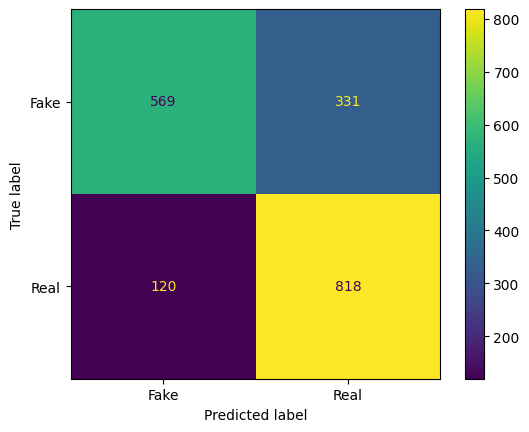

In [ ]:
SaveConfusionMatrix('logistic_Reg',y_test,y_pred,'images_ds_3')
SaveConfusionMatrix('svc',y_test,y_pred_svc,'images_ds_3')
SaveConfusionMatrix('random_forest',y_test,y_pred_rand,'images_ds_3')
SaveConfusionMatrix('knn',y_test,y_pred_knn,'images_ds_3')

### precison,recall f1_score

In [ ]:
lst_3=[]
lst_3.append(precision_recall_f1_score('Logistic Regression',y_test,y_pred))
lst_3.append(precision_recall_f1_score('Support vector class',y_test,y_pred_svc))
lst_3.append(precision_recall_f1_score('Random Forest',y_test,y_pred_rand))
lst_3.append(precision_recall_f1_score('K-Nearest Neighbour',y_test,y_pred_knn))

In [ ]:
prf=np.array(lst_3)
prf=prf.reshape(4,3)
prf_data=pd.DataFrame(prf,columns=['precision_score','recall_score','F1_score'])
prf_data['model']=['Logistic Regression','SVC','Random Forest','KNN']
prf_data.head()

,precision_score,recall_score,F1_score,model
0,0.769531,0.840085,0.803262,Logistic Regression
1,0.819215,0.845416,0.832109,SVC
2,0.829424,0.829424,0.829424,Random Forest
3,0.711923,0.872068,0.783900,KNN


In [ ]:
prf_data.to_csv('/content/drive/MyDrive/dataset/images_ds_3/prf.csv')

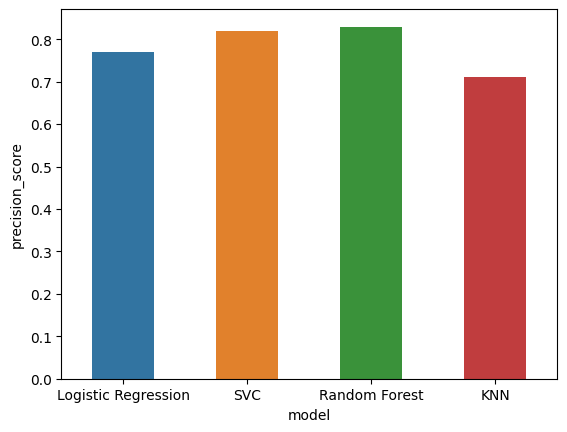

In [ ]:
sns.barplot(prf_data,x='model',y='precision_score',width=0.5)
plt.savefig('/content/drive/MyDrive/dataset/images_ds_3/precision.png')


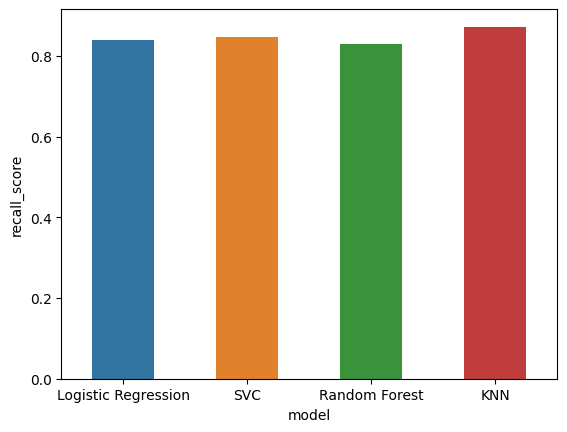

In [ ]:
sns.barplot(prf_data,x='model',y='recall_score',width=0.5)
plt.savefig('/content/drive/MyDrive/dataset/images_ds_3/recall.png')

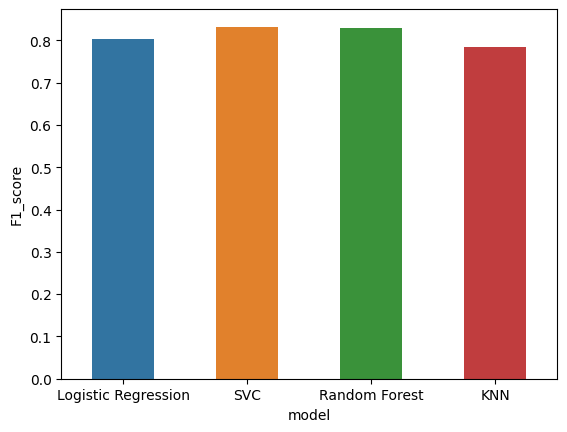

In [ ]:
sns.barplot(prf_data,x='model',y='F1_score',width=0.5)
plt.savefig('/content/drive/MyDrive/dataset/images_ds_3/f1.png')

# Model export and Testing

In [ ]:
# just for testing
# def featuresExForPrectDataTesting(title,text):
#   test_df=pd.DataFrame({'title':title,'text':text},index=[0,1])
#   return test_df

### feature extatraction on user predicted data

In [105]:
def featuresExForPrectData(title,text):
  df=pd.DataFrame({'title':title,'text':text},index=[0])
  df_temp=pd.DataFrame(np.array([0]),columns=['index'])
  df_temp['Number of Words']=df.apply(lambda x: total_word_cnt_fe(x['text'],x['title']),axis=1)
  df_temp['Number of character']=df.apply(lambda x: total_char_cnt_fe(x['text'],x['title']),axis=1)
  df_temp['Number of Specical-Symbol'] =df.apply(lambda x:special_character_fe(x['text'],x['title']),axis=1)
  df['Relative Specical-Symbol Count'] = df_temp['Number of Specical-Symbol']/df_temp["Number of character"]
  df_temp['Number of UpperCase'] = df.apply(lambda x:upper_case_fe(x['text'],x['title']),axis=1)
  df['Relative UpperCase Count'] = df_temp['Number of UpperCase']/df_temp["Number of character"]
  df_temp['Number of LowerCase'] = df.apply(lambda x:lower_case_fe(x['text'],x['title']),axis=1)
  df['Relative LowerCase Count'] = df_temp['Number of LowerCase']/df_temp["Number of character"]
  df[['short_sentence_cnt', 'long_sentence_cnt']] = df.apply(lambda x:length_sentences_fe(content = x['text'], headline = x['title']), axis=1)
  df_temp['Number of Question-Mark'] = df.apply(lambda x:question_marks_fe(x['text'],x['title']),axis=1)
  df['Relative Question-Mark Count'] = df_temp['Number of Question-Mark']/df_temp["Number of character"]
  df_temp['Number of Exclamation-Mark'] = df.apply(lambda x:exclamation_marks_fe(x['text'],x['title']),axis=1)
  df['Relative Exclamation-Mark Count'] = df_temp['Number of Exclamation-Mark']/df_temp["Number of character"]
  df_temp[['adjective_cnt', 'adverb_cnt']] = df.apply(lambda x:adj_and_adv_count_fe(content = x['text'], headline = x['title']), axis=1)
  df['Relative adjective Count'] = df_temp['adjective_cnt']/df_temp["Number of Words"]
  df['Relative adverb Count'] = df_temp['adverb_cnt']/df_temp["Number of Words"]
  df[['HyperLink Count', 'HyperLink Diversity','Phishing score']] = df.apply(lambda x:hyperlinks_fe(content = x['text'], headline = x['title']), axis=1)
  df['Sentimental Score'] = df.apply(lambda x:sentimental_score_fe(x['text'],x['title']),axis=1)
  df_temp['Sponsor Word Count'] = df.apply(lambda x:sponsorship_score_fe(content = x['text'], headline = x['title']), axis=1)
  df['Relative Sponsor Word Count'] = df_temp['Sponsor Word Count']/df_temp["Number of Words"]
  df['Symmetric_Score'] = df.apply(lambda x: headline_content_symmetry_score_fe(content = x['text'], headline = x['title']), axis=1)
  df[['gfi_readability_score', 'smog_readability_score', 'fkg_readability_score']] = df.apply(lambda x:readability_score_fe(content = x['text'], headline = x['title']), axis=1)
  df_temp[['present_tense_count', 'past_tense_count', 'future_tense_count']] = df.apply(lambda x:tense_score_fe(content = x['text'], headline = x['title']), axis=1)
  df['Relative present_tense_count'] = df_temp['present_tense_count']/df_temp["Number of Words"]
  df['Relative past_tense_count'] = df_temp['past_tense_count']/df_temp["Number of Words"]
  df['Relative future_tense_count'] = df_temp['future_tense_count']/df_temp["Number of Words"]
  df=df.drop(columns=['title','text'])
  
  return df
  # print('features extaction completed :)')

### user input as title and text

In [119]:
title=input("Enter Title")
text=input("Enter Article")


Enter TitleHow Supreme Court verdict on Shiv Sena may shape contours of Maharashtra politics
Enter ArticleConstitution bench ruling on Thursday that will have far-reaching implications for Maharashtra’s politics A Constitution bench ruling on Thursday that will have far-reaching implications for Maharashtra’s politics. The five-judge bench in the Supreme Court will deliver its judgment on a bunch of petitions pertaining to last year’s split in the Shiv Sena between Uddhav Thackeray and Eknath Shinde factions, and the then-governor Bhagat Singh Koshyari’s decision to invite Shinde to form the government along with the Bharatiya Janata Party after Thackeray chose to resign.  New Delhi, Jan 10 (ANI): A view of the Supreme Court building, the apex judicial body of India, in New Delhi on Tuesday. (ANI Photo) (Sanjay Sharma) New Delhi, Jan 10 (ANI): A view of the Supreme Court building, the apex judicial body of India, in New Delhi on Tuesday. (ANI Photo) (Sanjay Sharma)  Also read: ‘Idiotic

In [120]:
test_df=featuresExForPrectData(title,text)

In [125]:
test_df.head()

,Relative Specical-Symbol Count,Relative UpperCase Count,Relative LowerCase Count,short_sentence_cnt,long_sentence_cnt,Relative Question-Mark Count,Relative Exclamation-Mark Count,Relative adjective Count,Relative adverb Count,HyperLink Count,...,Phishing score,Sentimental Score,Relative Sponsor Word Count,Symmetric_Score,gfi_readability_score,smog_readability_score,fkg_readability_score,Relative present_tense_count,Relative past_tense_count,Relative future_tense_count
0,0.01654,0.043278,0.764457,0.05,0.95,0.0,0.000249,0.070571,0.026276,0,...,0,0.9975,0.001502,0.330255,15.49,15.3,14.7,0.027027,0.018769,0.032282


### model predition

In [121]:
std_scaler=StandardScaler()

In [122]:
x=std_scaler.fit_transform(test_df)

In [124]:
ans=rand_forest.predict(x)
print(ans)
if ans:
  print('our model prediction is REAL for given news')
else:
  print('our model prediction is FAKE for given news')

[0]
our model prediction is FAKE for given news
